# load packages

In [67]:
DATA_DIR = '/data/peer/wallet/Jupyter/2021_SPADE/2021_Bassez_BRCA/data/'

In [68]:
# scanpy packages 
import scanpy as sc
import scanpy.external as sce
import anndata as anndata
from anndata import AnnData

# other packages
import time
import os
import numpy as np
import seaborn as sns
import pandas as pd
import re
import h5py
import scipy

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.patches as patches
import matplotlib.colors as colors
import matplotlib.font_manager
%matplotlib inline


# other packages
import glob
from collections import OrderedDict
from scipy.sparse import csr_matrix
from scanpy.external.pp import magic
from scipy.stats import zscore
import scipy.cluster.hierarchy as hc
from statistics import median
import math
from typing import Union
import phenograph


In [ ]:
from scrnaseq_preprocessing_utils import *
from SPECTRA_processing_utils import *

In [69]:
!conda list

# packages in environment at /home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2:
#
# Name                    Version                   Build  Channel
_libgcc_mutex             0.1                 conda_forge    conda-forge
_openmp_mutex             4.5                       2_gnu    conda-forge
_r-mutex                  1.0.1               anacondar_1    conda-forge
alabaster                 0.7.12                     py_0    conda-forge
alsa-lib                  1.2.6.1              h7f98852_0    conda-forge
anndata                   0.8.0           py310hff52083_0    conda-forge
anyio                     3.6.1           py310hff52083_0    conda-forge
appdirs                   1.4.4              pyh9f0ad1d_0    conda-forge
argon2-cffi               21.3.0             pyhd8ed1ab_0    conda-forge
argon2-cffi-bindings      21.2.0          py310h5764c6d_2    conda-forge
arpack                    3.7.0                hdefa2d7_2    conda-forge
asttokens                 2.0.5            

In [71]:
#set style
sns.set_style('white')
# define colors
color_map_clusters = ["#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059",
"#FFDBE5", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",
"#5A0007", "#809693", "#1B4400", "#4FC601", "#3B5DFF", "#4A3B53", "#FF2F80",
"#61615A", "#BA0900", "#6B7900", "#00C2A0", "#FFAA92", "#FF90C9", "#B903AA", "#D16100",
"#DDEFFF", "#000035", "#7B4F4B", "#A1C299", "#300018", "#0AA6D8", "#013349", "#00846F",
"#372101", "#FFB500", "#C2FFED", "#A079BF", "#CC0744", "#C0B9B2", "#C2FF99", "#001E09",
"#00489C", "#6F0062", "#0CBD66", "#EEC3FF", "#456D75", "#B77B68", "#7A87A1", "#788D66",
"#885578", "#FAD09F", "#FF8A9A", "#D157A0", "#BEC459", "#456648", "#0086ED", "#886F4C",
"#34362D", "#B4A8BD", "#00A6AA", "#452C2C", "#636375", "#A3C8C9", "#FF913F", "#938A81",
"#575329", "#00FECF", "#B05B6F", "#8CD0FF", "#3B9700", "#04F757", "#C8A1A1", "#1E6E00",
"#7900D7", "#A77500", "#6367A9", "#A05837", "#6B002C", "#772600", "#D790FF", "#9B9700",
"#549E79", "#FFF69F", "#201625", "#72418F", "#BC23FF", "#99ADC0", "#3A2465", "#922329",
"#5B4534", "#FDE8DC", "#404E55", "#0089A3", "#CB7E98", "#A4E804", "#324E72", "#6A3A4C"]

color_map_clusters_nogrey = ["#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",
"#5A0007", "#809693", "#1B4400", "#4FC601", "#3B5DFF", "#4A3B53", "#FF2F80",
"#61615A", "#BA0900", "#6B7900", "#00C2A0", "#FFAA92", "#FF90C9", "#B903AA", "#D16100",
"#DDEFFF", "#000035", "#7B4F4B", "#A1C299", "#300018", "#0AA6D8", "#013349", "#00846F",
"#372101", "#FFB500", "#C2FFED", "#A079BF", "#CC0744", "#C0B9B2", "#C2FF99", "#001E09",
"#00489C", "#6F0062", "#0CBD66", "#EEC3FF", "#456D75", "#B77B68", "#7A87A1", "#788D66",
"#885578", "#FAD09F", "#FF8A9A", "#D157A0", "#BEC459", "#456648", "#0086ED", "#886F4C",
"#34362D", "#B4A8BD", "#00A6AA", "#452C2C", "#636375", "#A3C8C9", "#FF913F", "#938A81",
"#575329", "#00FECF", "#B05B6F", "#8CD0FF", "#3B9700", "#04F757", "#C8A1A1", "#1E6E00",
"#7900D7", "#A77500", "#6367A9", "#A05837", "#6B002C", "#772600", "#D790FF", "#9B9700",
"#549E79", "#FFF69F", "#201625", "#72418F", "#BC23FF", "#99ADC0", "#3A2465", "#922329",
"#5B4534", "#FDE8DC", "#404E55", "#0089A3", "#CB7E98", "#A4E804", "#324E72", "#6A3A4C"]

blue_red = ['#0E518F','#DF480F']

batlow_20 = ['#1d2356','#1d2b59',
'#14375e',
'#134460',
'#1c5261',
'#235f5f',
'#396a58',
'#4c714e',
'#607843',
'#757e36',
'#8d8532',
'#a78b30',
'#c49138',
'#dc954d',
'#f09c6a',
'#f8a487',
'#f8aca2',
'#f8b5be',
'#f8c2d9',
'#eecbe1'] 
import random
random.seed(1)
random.shuffle(batlow_20)

subtype_color_dict = {'TAM':'#FFFF00',
                 'DC_cDC2A':'#1CE6FF',
                 'pDC':'#FF34FF',
                 'M-MDC':'#FF4A46',
                 'mono_c':'#008941',
                 'mast':'#006FA6',
                      'TAM_TRMac':'#456D75',
                 'DC_cDC1':'#A30059',
                 'Gr-MDC':'#7A4900',
                 'DC_Langerhans':'#0000A6',
                      'DC_AXLpos_ITGAXpos':'#0CBD66',
                      'DC_FDC_PTPRCpos':'#EEC3FF',
                'DC_cDC3':'#63FFAC',
                'CD8_T':'#B79762',
                'Treg':'#004D43',
                'CD4_T':'#8FB0FF',
                'CD8_T':'#997D87',
                 'NK':'#5A0007',
                 'gdT':'#809693',
                    'ILC3':'#7900D7',
                       'CD8_T_KLRG1pos_effector_preexhausted':'#4FC601',
                 'CD4_T_naive':'#3B5DFF',
                 'CD4_T_TH1':'#4A3B53',
                 'CD8_T_TRM':'#FF2F80',
                'CD8_T_TRM_exhausted':'#61615A',
                 'CD8_T_naive':'#BA0900',
                 'CD8_T_KLRG1pos_effector_preexhausted':'#6B7900',
             'CD4_T_naive_low_libsize':'#00C2A0',
                 'CD8_T_naive':'#FFAA92',
             'NK_CD56bright':'#FF90C9',
                 'CD8_T_TEM_effector_exhausted-progenitor':'#B903AA',
            'gdT':'#D16100',
              'CD8_T_KLRG1pos_effector_nonexhausted':'#DDEFFF',
              'CD8_T_TRM_exhausted_proliferating':'#000035',
            'CD4_T_TH1_proliferating':'#7B4F4B',
               'NK_CD56dim':'#A1C299',
               'Treg':'#300018',
                  'CD8_T_KLRG1pos_effector_preexhausted':'#0AA6D8',
                         'MDC':'#013349',
                 'DC':'#00846F',
                'mixed_T_M':'#636375',
                        'B_memory':'#372101',
                
                 'B_naive':'#FFB500',
                'plasma':'#C2FFED',
                'B_GC':'#A079BF',
                    'B_memory_switched':'#CC0744',
                'plasma_IgA':'#C0B9B2',
                 'B_memory_double_neg':'#C2FF99',
               'plasma_IgG':'#001E09',
                'plasmablast':'#00489C',
               'plasma_Be1':'#6F0062',
                     'M':'#B77B68',
                     'TNK':'#7A87A1',
                     'B':'#788D66',
                     'TAM_MKlike':'#885578',
                     'mono':'#34362D',
                     'mono_c':'#B4A8BD',
                     'mono_nc':'#00A6AA',
                     'ILC1':'#452C2C',
                     'CD4_T_TFH':'#A3C8C9',
                     'CD4_T_TFH_exhausted-progenitor':'#FF913F',
                     'CD4_T_TSCM':'#938A81',
                     'CD8_T_KLRG1neg_effector_preexhausted':'#575329',
                     'CD8_T_KLRG1pos_effector_exhausted':'#00FECF',
                     'CD8_T_TRM_nonexhausted':'#B05B6F',
                     'CD8_T_innate-like':'#8CD0FF',
                     'TNK_proliferating':'#3B9700',
                     'NK_CD56dim_proliferating':'#04F757',
                     'T':'#C8A1A1',
                     'T_proliferating':'#1E6E00',
                     'B_memory':"#BC23FF",
                      'B_naive':"#A77500",
                      'plasma':"#6367A9",
                 'B_GC':"#A05837",
                      'B_memory_switched':"#6B002C",
                 'B_naive':"#772600",
              'plasma_IgA':"#D790FF",
                'B_memory_double_neg':"#9B9700",
               'plasma_IgG':"#549E79",
                 'plasmablast':"#FFF69F",
                'plasma_IgG':"#201625",
                 'plasma_Be1':"#72418F",
                      'B':"#922329", 
                      'TNK':"#99ADC0",
                      'M': "#3A2465",
                      'nan':'#000000',
                      'B_GC_proliferating':'#5B4534',
                      'B_memory_switched_Be1':'#FDE8DC',
                      'B_memory_switched_proliferating':'#404E55',
                      'plasma_IgG_Be1':'#0089A3',
                       'B_proliferating':'#CB7E98'
                }

perturbation_map = ['#EFD060','#0289DE','#0289DE','#DCA6C4']
stage_map = ['#EFD060','#0289DE','#67C6F8','#DCA6C4']
stage_map_2 = ['#EFD060','#0289DE','#DCA6C4']
perturbation_stage_map_2 = ['#F95957', '#FF0300','#EFD060','#0289DE','#0289DE','#DCA6C4','#EFD060','#0289DE','#DCA6C4']
perturbation_stage_map = ['#F95957', '#FF0300','#e1e1e1','#e1e1e1','#e1e1e1','#e1e1e1', '#EFD060','#0289DE','#DCA6C4']
color_map_clusters_plt = cm = LinearSegmentedColormap.from_list(
        'color_map_clusters', color_map_clusters)

#scanpy layout
sc.set_figure_params(scanpy=True, dpi=150, dpi_save=400, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=True, ipython_format='png2x')
sns.set_style('white')

# Annotate cells

In [10]:
adata = sc.read('/data/peer/wallet/Jupyter/2021_SPADE/2021_Bassez_BRCA/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_M_scran_plus_raw_obs_clustered_15k_hv_genes_annotate_211208.h5ad')

FileNotFoundError: [Errno 2] Unable to open file (unable to open file: name = '/data/peer/wallet/Jupyter/2021_SPADE/2021_Bassez_BRCA/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_M_scran_plus_raw_obs_clustered_15k_hv_genes_annotate_211208.h5ad', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

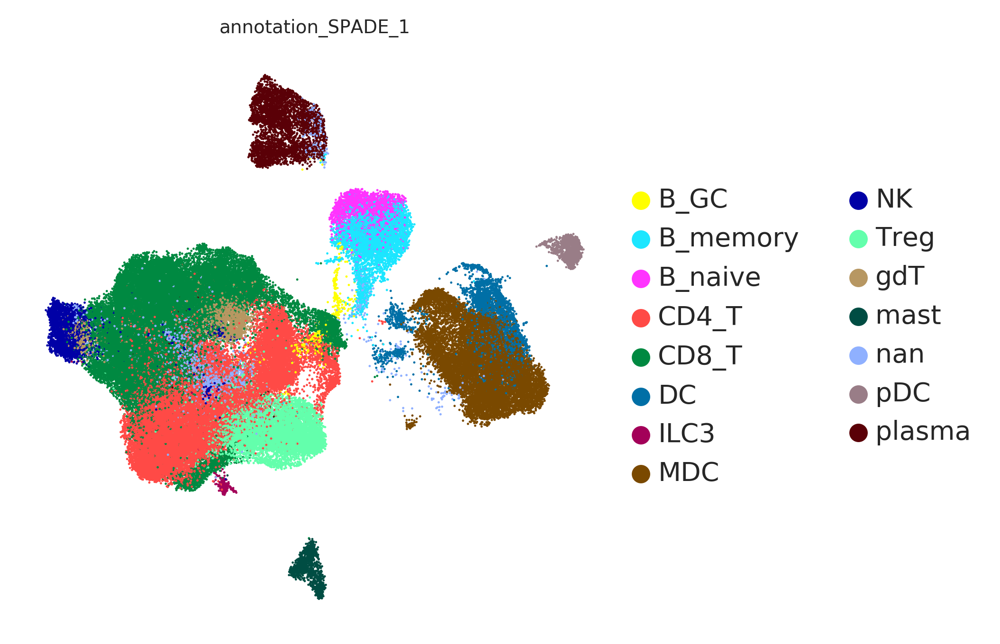

In [40]:
sc.pl.umap(adata, color = ['annotation_SPADE_1'], s = 3, palette=color_map_clusters_nogrey, legend_fontsize = 10, vmin=0)

## TNK

In [60]:
# Annotate cells

#define adata, clusters and marker genes for heatmaps here
adata_path = '/data/peer/wallet/Jupyter/2021_SPADE/2021_Bassez_BRCA/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_TNK_scran_plus_raw_obs_7500_hv_genes.h5ad'
adata_save_path = '/data/peer/wallet/Jupyter/2021_SPADE/2021_Bassez_BRCA/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_TNK_scran_plus_raw_obs_7500_hv_genes_annotated_211208.h5ad'
pheno_annotate = 'pheno_var_TNK_k30'
prefix = 'TNK_'

#mappings

##subtype_1
subtype_0_dict = {'TNK_0': 'TNK',
                 'TNK_1': 'TNK',
                 'TNK_2': 'TNK',
                 'TNK_3': 'TNK',
                 'TNK_4': 'TNK',
                 'TNK_5': 'TNK',
                 'TNK_6': 'TNK',
                 'TNK_7': 'TNK',
                 'TNK_8': 'TNK',
                 'TNK_9': 'TNK',
                 'TNK_10': 'TNK',
                 'TNK_11': 'TNK',
                 'TNK_12': 'TNK',
                 'TNK_13': 'TNK',
                 'TNK_14': 'TNK',
                 'TNK_15': 'TNK',
                  'TNK_16': 'TNK',
                   'TNK_17': 'TNK',
                  'TNK_18': 'TNK',
                  'TNK_19': 'TNK',
                  'TNK_20': 'TNK',
                    'TNK_21': 'TNK',
                      'TNK_22': 'TNK',
                }
subtype_1_dict = {'TNK_0': 'CD8_T',
                 'TNK_1': 'Treg',
                 'TNK_2': 'CD4_T',
                 'TNK_3': 'CD4_T',
                 'TNK_4': 'CD4_T',
                 'TNK_5': 'CD4_T',
                 'TNK_6': 'CD8_T',
                 'TNK_7': 'CD8_T',
                 'TNK_8': 'CD8_T',
                 'TNK_9': 'CD8_T',
                 'TNK_10': 'CD4_T',
                 'TNK_11': 'CD8_T',
                 'TNK_12': 'NK',
                 'TNK_13': 'CD8_T',
                 'TNK_14': 'gdT',
                 'TNK_15': 'CD8_T',
                  'TNK_16': 'CD8_T',
                   'TNK_17': 'CD4_T',
                  'TNK_18': 'NK',
                  'TNK_19': 'Treg',
                  'TNK_20': 'CD8_T',
                    'TNK_21': 'ILC3',
                      'TNK_22': 'CD8_T',
                }

subtype_2_dict = {'TNK_0': 'CD8_T_KLRG1pos_effector_preexhausted',
                 'TNK_1': 'Treg',
                 'TNK_2': 'CD4_T_naive',
                 'TNK_3': 'CD4_T_naive',
                 'TNK_4': 'CD4_T_naive',
                 'TNK_5': 'CD4_T_TH1',
                 'TNK_6': 'CD8_T_TRM_nonexhausted',
                 'TNK_7': 'CD8_T_TRM_exhausted',
                 'TNK_8': 'CD8_T_naive',
                 'TNK_9': 'CD8_T_KLRG1pos_effector_preexhausted',
                 'TNK_10': 'CD4_T_naive_low_libsize',
                 'TNK_11': 'CD8_T_naive',
                 'TNK_12': 'NK_CD56bright',
                 'TNK_13': 'CD8_T_TEM_effector_exhausted-progenitor',
                 'TNK_14': 'gdT',
                 'TNK_15': 'CD8_T_KLRG1pos_effector_nonexhausted',
                  'TNK_16': 'CD8_T_TRM_exhausted_proliferating',
                   'TNK_17': 'CD4_T_TH1_proliferating',
                  'TNK_18': 'NK_CD56dim',
                  'TNK_19': 'Treg',
                  'TNK_20': 'CD8_T_KLRG1pos_effector_preexhausted',
                    'TNK_21': 'ILC3',
                      'TNK_22': 'CD8_T_TRM_exhausted',
                }


In [61]:
#Annotate!

adata = sc.read(adata_path)

#create unique subset cluster names to later merge with in one .obs column with the other subsets (B, M..)
pheno_k10_subset_list = [i+j for i,j in zip(len(adata.obs[pheno_annotate])*[prefix], list(map(str, adata.obs[pheno_annotate])))]

#add to .obs element
adata.obs['pheno_annotate'] = pheno_k10_subset_list



#subtype_3_dict =   'M_12':'M_mem_switched_IgA_immature_plasma'

#map with dictionary

adata.obs['annotation_SPADE_0'] = pd.Categorical(adata.obs['pheno_annotate'].map(subtype_0_dict))
adata.obs['annotation_SPADE_1'] = pd.Categorical(adata.obs['pheno_annotate'].map(subtype_1_dict))
adata.obs['annotation_SPADE_2'] = pd.Categorical(adata.obs['pheno_annotate'].map(subtype_2_dict))

In [62]:
adata.varm['PCs'].shape

(19304, 24)

In [ ]:
sc.pl.umap(adata, color = ['CD3G','CD3D','CD3E','TRAC','NCAM1','CD4','CD8A','MKI67','TRDC','TRGC1','MKI67'],  layer = None, s = 30, cmap='Spectral_r', legend_fontsize = 10,vmin=0)
sc.pl.umap(adata, color = ['batch'],  layer = None, s = 30, palette=color_map_clusters_nogrey, legend_fontsize = 10,vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_0'],  layer = None, s = 30, palette=subtype_color_dict, legend_fontsize = 10,vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_1'],  layer = None, s = 30, palette=subtype_color_dict, legend_fontsize = 10,vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_2'],  layer = None, s = 30, palette=subtype_color_dict, legend_fontsize = 10,vmin=0)

In [ ]:
sc.pl.tsne(adata, color = ['CD3G','CD3D','CD3E','TRAC','NCAM1','CD4','CD8A','MKI67','TRDC','TRGC1','MKI67'],  layer = None, s = 30, cmap='Spectral_r', legend_fontsize = 10,vmin=0)
sc.pl.tsne(adata, color = ['batch'],  layer = None, s = 30, palette=color_map_clusters_nogrey, legend_fontsize = 10,vmin=0)
sc.pl.tsne(adata, color = ['annotation_SPADE_0'],  layer = None, s = 30, palette=subtype_color_dict, legend_fontsize = 10,vmin=0)
sc.pl.tsne(adata, color = ['annotation_SPADE_1'],  layer = None, s = 30, palette=subtype_color_dict, legend_fontsize = 10,vmin=0)
sc.pl.tsne(adata, color = ['annotation_SPADE_2'],  layer = None, s = 30, palette=subtype_color_dict, legend_fontsize = 10,vmin=0)

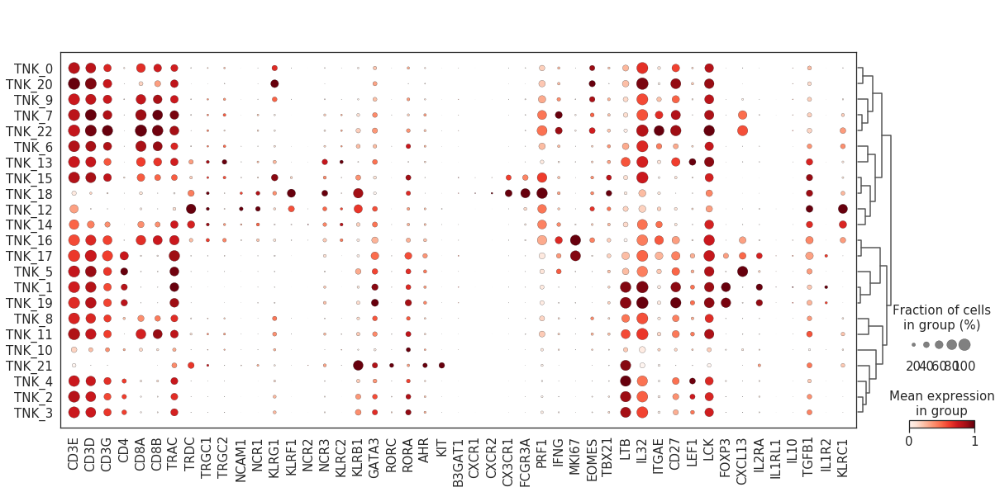

In [65]:
#dotplot
pheno_plot = 'pheno_annotate'
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_plot)
sc.pl.dotplot(adata, ['CD3E','CD3D','CD3G','CD4','CD8A','CD8B','TRAC','TRDC','TRGC1','TRGC2','NCAM1','NCR1','KLRG1','KLRF1','NCR2','NCR3','KLRC2','KLRB1','GATA3','RORC','RORA','AHR','KIT','B3GAT1','CXCR1','CXCR2','CX3CR1','FCGR3A','PRF1','IFNG','MKI67','EOMES','TBX21','LTB','IL32','ITGAE','CD27','LEF1','LCK','FOXP3','CXCL13','IL2RA','IL1RL1','IL10','TGFB1','IL1R2','KLRC1'], groupby=pheno_plot, dendrogram=True, standard_scale='var')

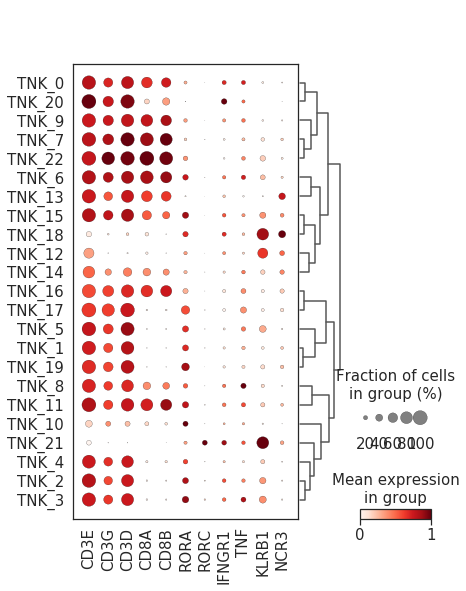

In [66]:
#dotplot
pheno_plot = 'pheno_annotate'
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_plot)
sc.pl.dotplot(adata, ['CD3E','CD3G','CD3D', 'CD8A','CD8B', 'RORA', 'RORC', 'IFNGR1', 'TNF', 'KLRB1','NCR3'], groupby=pheno_plot, dendrogram=True, standard_scale='var')

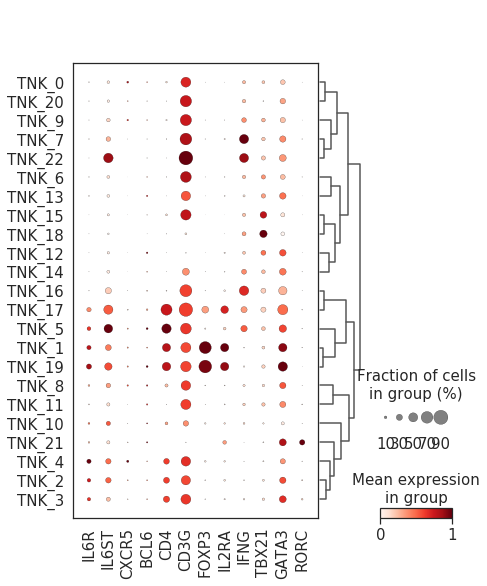

In [67]:
#dotplot
pheno_plot = 'pheno_annotate'
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_plot)
sc.pl.dotplot(adata, ['IL6R','IL6ST','CXCR5','BCL6','CD4', 'CD3G','FOXP3','IL2RA','IFNG','TBX21','GATA3','RORC'], groupby=pheno_plot, dendrogram=True, standard_scale='var')

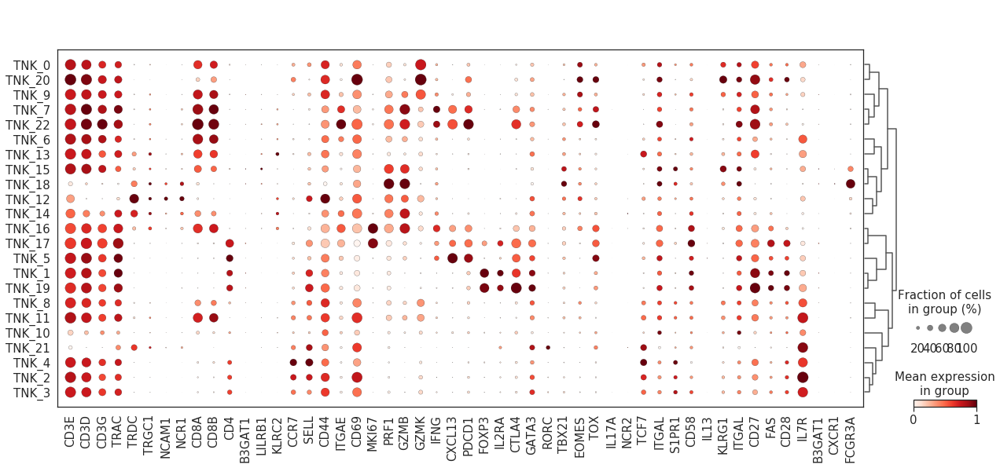

In [68]:
#dotplot
pheno_plot = 'pheno_annotate'
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_plot)
sc.pl.dotplot(adata, ['CD3E','CD3D','CD3G','TRAC','TRDC','TRGC1','NCAM1','NCR1','CD8A','CD8B','CD4','B3GAT1','LILRB1','KLRC2','CCR7','SELL','CD44','ITGAE','CD69','MKI67','PRF1','GZMB','GZMK','IFNG','CXCL13','PDCD1','FOXP3','IL2RA','CTLA4','GATA3','RORC','TBX21','EOMES','TOX','IL17A','NCR2','TCF7','ITGAL','S1PR1','CD58','IL13','KLRG1','ITGAL','CD27','FAS','CD28','IL7R','B3GAT1','CXCR1','FCGR3A'], groupby=pheno_plot, dendrogram=True, standard_scale='var')

In [73]:
adata.obs['pheno_annotate'] = pd.Categorical(list(adata.obs['pheno_annotate'].astype(str)))

In [75]:
adata

AnnData object with n_obs × n_vars = 69456 × 19304
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k2

In [76]:
adata.write(adata_save_path)
print('AnnData object saved to:', adata_save_path)

AnnData object saved to: /data/peer/wallet/Jupyter/2021_SPADE/2021_Bassez_BRCA/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_TNK_scran_plus_raw_obs_7500_hv_genes_annotated_211208.h5ad


## myeloid

In [12]:
# Annotate cells

#define adata, clusters and marker genes for heatmaps here
adata_path = '/data/peer/wallet/Jupyter/2021_SPADE/2021_Bassez_BRCA/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_M_scran_plus_raw_obs_clustered_15k_hv_genes.h5ad'
adata_save_path ='/data/peer/wallet/Jupyter/2021_SPADE/2021_Bassez_BRCA/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_M_scran_plus_raw_obs_clustered_15k_hv_genes_annotate_211208.h5ad'
pheno_annotate = 'pheno_var_M_k20'
prefix = 'M_'
color_dict = subtype_color_dict 

#mappings

##subtype_1

subtype_0_dict = {'M_0': 'M',
                 'M_1': 'M',
                 'M_2': 'M',
                 'M_3': 'M',
                 'M_4': 'M',
                 'M_5': 'M',
                 'M_6': 'M',
                 'M_7': 'M',
                 'M_8': 'M',
                 'M_9': 'M',
                 'M_10': 'M',
                 'M_11': 'M',
                 'M_12': 'M',
                 'M_13': 'M',
                 'M_14': 'M',
                 'M_15': 'M',
                 'M_16': 'M',
                 'M_17': 'M',
                 'M_18': 'M',
                  'M_19': 'M',
                  'M_20': 'M',
                  'M_21': 'M',
                  'M_22': 'M',
                 'M_23': 'M',
                 'M_24': 'mixed_T_M',
                 'M_25': 'M',
                 'M_26': 'M',
                 'M_27': 'M',
                 'M_28': 'M',
                 'M_29': 'M'}

subtype_1_dict = {'M_0': 'MDC',
                 'M_1': 'MDC',
                 'M_2': 'MDC',
                 'M_3': 'MDC',
                 'M_4': 'MDC',
                 'M_5': 'MDC',
                 'M_6': 'MDC',
                 'M_7': 'MDC',
                 'M_8': 'pDC',
                 'M_9': 'MDC',
                 'M_10': 'MDC',
                 'M_11': 'MDC',
                 'M_12': 'MDC',
                 'M_13': 'mast',
                 'M_14': 'DC',
                 'M_15': 'DC',
                 'M_16': 'MDC',
                 'M_17': 'MDC',
                 'M_18': 'MDC',
                  'M_19': 'DC',
                  'M_20': 'MDC',
                  'M_21': 'mast',
                  'M_22': 'DC',
                  'M_23': 'DC',
                 'M_24': 'mixed_T_M',
                 'M_25': 'DC',
                 'M_26': 'DC',
                 'M_27': 'MDC',
                 'M_28': 'MDC',
                 'M_29': 'pDC'}



subtype_2_dict = {'M_0': 'TAM',
                 'M_1': 'Gr-MDC',
                 'M_2': 'TAM',
                 'M_3': 'M-MDC',
                 'M_4': 'Gr-MDC',
                 'M_5': 'TAM',
                 'M_6': 'TAM',
                 'M_7': 'M-MDC',
                 'M_8': 'pDC',
                 'M_9': 'TAM',
                 'M_10': 'M-MDC',
                 'M_11': 'TAM',
                 'M_12': 'TAM',
                 'M_13': 'mast',
                 'M_14': 'DC_cDC2A',
                 'M_15': 'DC_FDC_PTPRCpos',
                 'M_16': 'TAM',
                 'M_17': 'Gr-MDC',
                 'M_18': 'TAM',
                  'M_19': 'DC_Langerhans',
                  'M_20': 'TAM',
                  'M_21': 'mast',
                  'M_22': 'DC_AXLpos_ITGAXpos',
                  'M_23': 'DC_cDC1',
                 'M_24': 'mixed_T_M',
                 'M_25': 'DC_cDC3',
                 'M_26': 'DC_cDC3',
                 'M_27': 'TAM',
                 'M_28': 'TAM',
                 'M_29': 'pDC'}

In [13]:
#Annotate!

adata = sc.read(adata_path)

#create unique subset cluster names to later merge with in one .obs column with the other subsets (B, M..)
pheno_k10_subset_list = [i+j for i,j in zip(len(adata.obs[pheno_annotate])*[prefix], list(map(str, adata.obs[pheno_annotate])))]

#add to .obs element
adata.obs['pheno_annotate'] = pheno_k10_subset_list



#subtype_3_dict =   'M_12':'M_mem_switched_IgA_immature_plasma'

#map with dictionary

adata.obs['annotation_SPADE_0'] = pd.Categorical(adata.obs['pheno_annotate'].map(subtype_0_dict))
adata.obs['annotation_SPADE_1'] = pd.Categorical(adata.obs['pheno_annotate'].map(subtype_1_dict))
adata.obs['annotation_SPADE_2'] = pd.Categorical(adata.obs['pheno_annotate'].map(subtype_2_dict))

In [37]:
# delete population containing both myeloid cells and T cells
adata = adata[adata.obs['annotation_SPADE_1']!='mixed_T_M']

In [ ]:
sc.pl.umap(adata, color = ['total_molecules'],  layer = None, s = 30, cmap='Spectral_r', legend_fontsize = 10,vmin=0,vmax=4000)
sc.pl.umap(adata, color = ['pheno_var_M_k20'],  layer = None, s = 30, palette=color_map_clusters_nogrey, legend_fontsize = 10,vmin=0)




In [ ]:
sc.pl.umap(adata, color = ['CD68','IRF4','IRF8','HDC','CD3E','CD8A','ITGAX','AXL','CCR7','BATF3',
                          'FUT4','FCGR3B','MARCO','CD163','APOE','C1QA'],  layer = None, s = 30, cmap='Spectral_r', legend_fontsize = 10,vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_0'],  layer = None, s = 30, palette=color_dict, legend_fontsize = 10,vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_1'],  layer = None, s = 30, palette=color_dict, legend_fontsize = 10,vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_2'],  layer = None, s = 30, palette=color_dict, legend_fontsize = 10,vmin=0)

In [40]:
adata.write(adata_save_path)
print('AnnData object saved to:', adata_save_path)

AnnData object saved to: /data/peer/wallet/Jupyter/2021_SPADE/2021_Bassez_BRCA/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_M_scran_plus_raw_obs_clustered_15k_hv_genes_annotate_211127.h5ad


## recalculate embedding

In [41]:
adata_path = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_M_scran_plus_raw_obs_clustered_15k_hv_genes_annotate_211127.h5ad'
save_path = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_M_scran_plus_raw_obs_clustered_15k_hv_genes_annotate_211127_high-quality-cells.h5ad'

#parameters
save_adata =True

#clustering parameters 
pheno_names = ['pheno_Mhq_k10', 'pheno_Mhq_k20', 'pheno_Mhq_k30', 'pheno_Mhq_k40', 'pheno_Mhq_k50', 'pheno_Mhq_k60',
              'pheno_Mhq_k70','pheno_Mhq_k80','pheno_Mhq_k90','pheno_Mhq_k100']

pheno_k = [10,20,30,40,50,60,70,80,90,100]
color_dict = subtype_color_dict 

In [42]:
#annotate low libsize cells detected in clustering of subsets

low_quality_clusters = ['M_20','M_11','M_2','M_0','M_25']

adata.obs['low_quality_cell'] = adata.obs['pheno_annotate'].isin(low_quality_clusters)

In [43]:
adata

AnnData object with n_obs × n_vars = 22149 × 19024
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k2

In [44]:
#filter out low quality cells
adata = adata[~adata.obs['low_quality_cell']]
adata

View of AnnData object with n_obs × n_vars = 16640 × 19024
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'phen

In [45]:
adata

View of AnnData object with n_obs × n_vars = 16640 × 19024
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'phen

In [46]:
adatas = [adata]

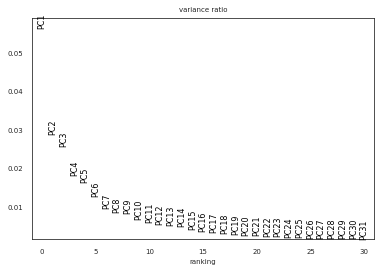

In [48]:
#PCA
%matplotlib inline

sc.tl.pca(adata, svd_solver='arpack',n_comps=100) 
sc.pl.pca_variance_ratio(adata,log=False)

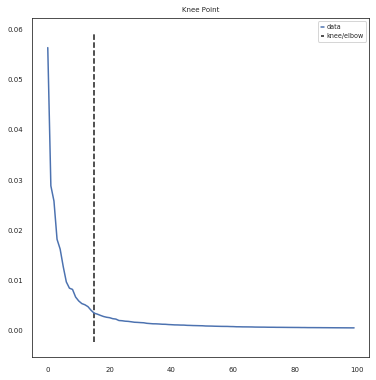

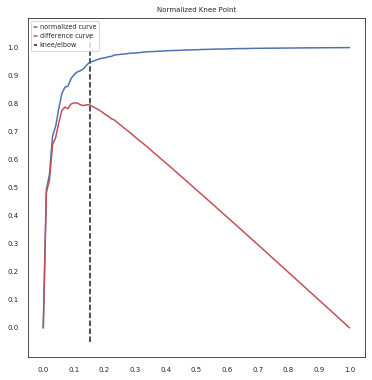

Kneepoint happens at PC: 15
15 PC explain 21.67259086854756 % of variance


In [49]:
a = adata.copy()# PCs kneepoint
x = [i for i in range(len(a.uns["pca"]["variance_ratio"]))]
y = list(a.uns["pca"]["variance_ratio"])
kneedle = KneeLocator(x,
                      y,
                      S=1,
                      curve='convex',
                      direction='decreasing',
                      online=False)
kn_pc = round(kneedle.knee, 3)
kneedle.plot_knee()
plt.show()
kneedle.plot_knee_normalized()
plt.show()
print("Kneepoint happens at PC:", kn_pc)

exp_var = sum(adata.uns['pca']['variance_ratio'][:kn_pc])
exp_var_test_percent = exp_var*100
print(kn_pc,'PC explain',exp_var_test_percent, '% of variance')


In [50]:
#find number of PCs explaining at least 20% of variance
tested_PC_number = kn_pc

while exp_var_test_percent <20:
    tested_PC_number = tested_PC_number+1
    exp_var_test = sum(adata.uns['pca']['variance_ratio'][0:tested_PC_number])
    exp_var_test_percent = exp_var_test*100
    print(tested_PC_number, 'PC explain',exp_var_test_percent, '% of variance')
    if tested_PC_number == 100:
        break
        print('ended loop, 100 PC reached')

In [51]:
#set number of components according to kneepoint and explained variance
n_comps = tested_PC_number
print('number of PCs for clusterings/embeddings is:', n_comps)

number of PCs for clusterings/embeddings is: 15


/home/wallet/miniconda3/envs/2021_Peer_SPADE_sample_data_exploration/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2630: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


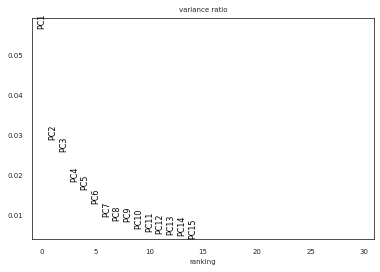

In [52]:
sc.tl.pca(adata, svd_solver='arpack',n_comps=n_comps) 
sc.pl.pca_variance_ratio(adata,log=False)

In [53]:
for i in adatas:
    sc.pp.neighbors(i, n_neighbors=10, method= 'umap', n_pcs=n_comps)
    sc.tl.umap(i)

In [54]:
for i in adatas:
    sc.tl.tsne(i, random_state = 7)

In [55]:
for i in adatas:
    sc.tl.diffmap(i, n_comps=15, neighbors_key=None, copy=False)

In [56]:
for i in adatas:
    sc.tl.draw_graph(i, layout='fa', init_pos=None, root=None, random_state=0, n_jobs=None, adjacency=None, key_added_ext=None, neighbors_key=None, obsp=None, copy=False)

In [57]:
for i in adatas:
    for j,k in enumerate(pheno_names):
        result_pheno_ndf_all = sce.tl.phenograph(i.obsm['X_pca'], k = pheno_k[j])
        i.obs[k] = pd.Categorical(result_pheno_ndf_all[0])

Finding 10 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 2.149423599243164 seconds
Jaccard graph constructed in 27.72368025779724 seconds
Wrote graph to binary file in 0.09119415283203125 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.890002
After 2 runs, maximum modularity is Q = 0.891865
Louvain completed 22 runs in 19.995951652526855 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 77.37203407287598 seconds
Finding 20 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 1.0859708786010742 seconds
Jaccard graph constructed in 28.101378202438354 seconds
Wrote graph to binary file in 0.1449577808380127 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.857794
After 2 runs, maximum modularity is Q = 0.860764
After 12 runs, maximum modularity is Q = 0.862501
Louvain completed 32 runs in 29.64891004562378 seconds

In [58]:
for i in adatas:
    a = magic(i, copy=True, verbose=True, solver= 'exact', n_pca=i.obsm['X_pca'].shape[1], knn=5, t=3)
    i.layers['imputed'] = a.X

Calculating MAGIC...
  Running MAGIC on 16640 cells and 19024 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 5.25 seconds.
    Calculating KNN search...
    Calculated KNN search in 4.42 seconds.
    Calculating affinities...
    Calculated affinities in 4.22 seconds.
  Calculated graph and diffusion operator in 13.91 seconds.
  Running MAGIC with `solver='exact'` on 19024-dimensional data may take a long time. Consider denoising specific genes with `genes=<list-like>` or using `solver='approximate'`.
  Calculating imputation...


/home/wallet/.local/lib/python3.8/site-packages/magic/magic.py:500: FutureWarning: The SparseDataFrame class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  and isinstance(X, (pd.SparseDataFrame, sparse.spmatrix))


  Calculated imputation in 85.03 seconds.


/home/wallet/.local/lib/python3.8/site-packages/magic/utils.py:135: FutureWarning: The SparseDataFrame class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  if isinstance(target_data, pd.SparseDataFrame):


Calculated MAGIC in 100.00 seconds.


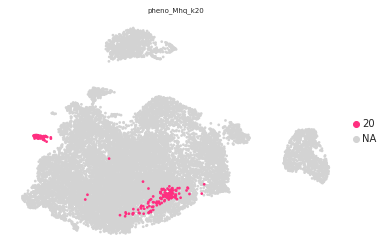

In [59]:
sc.pl.umap(adata, color = ['pheno_Mhq_k20'],groups=[20], layer = None, s = 30, palette=color_map_clusters_nogrey, legend_fontsize = 10,vmin=0)


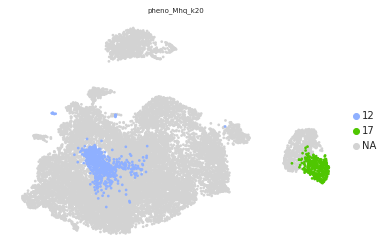

In [60]:
sc.pl.umap(adata, color = ['pheno_Mhq_k20'],groups=[12,17], layer = None, s = 30, palette=color_map_clusters_nogrey, legend_fontsize = 10,vmin=0)


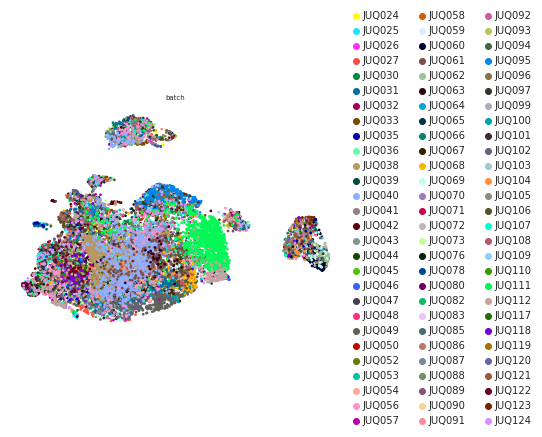

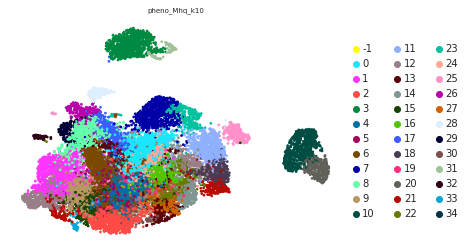

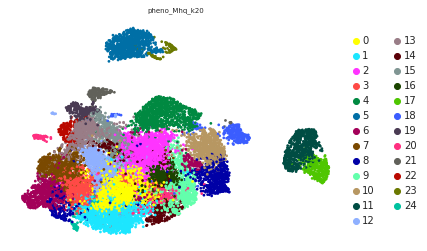

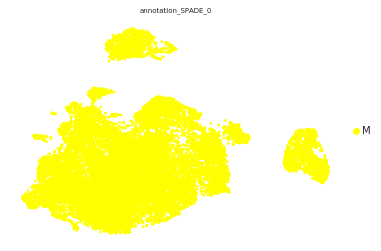

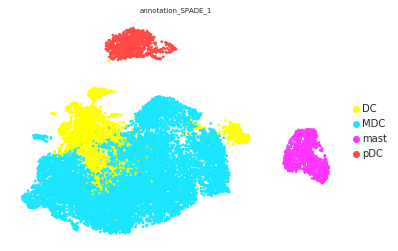

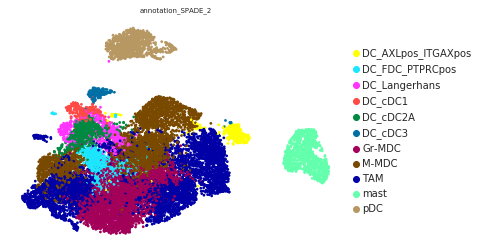

In [61]:
sc.pl.umap(adata, color = ['batch'],  layer = None, s = 30, palette=color_map_clusters_nogrey, legend_fontsize = 10,vmin=0)
sc.pl.umap(adata, color = ['pheno_Mhq_k10'],  layer = None, s = 30, palette=color_map_clusters_nogrey, legend_fontsize = 10,vmin=0)
sc.pl.umap(adata, color = ['pheno_Mhq_k20'],  layer = None, s = 30, palette=color_map_clusters_nogrey, legend_fontsize = 10,vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_0'],  layer = None, s = 30, palette=color_map_clusters_nogrey, legend_fontsize = 10,vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_1'],  layer = None, s = 30, palette=color_map_clusters_nogrey, legend_fontsize = 10,vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_2'],  layer = None, s = 30, palette=color_map_clusters_nogrey, legend_fontsize = 10,vmin=0)

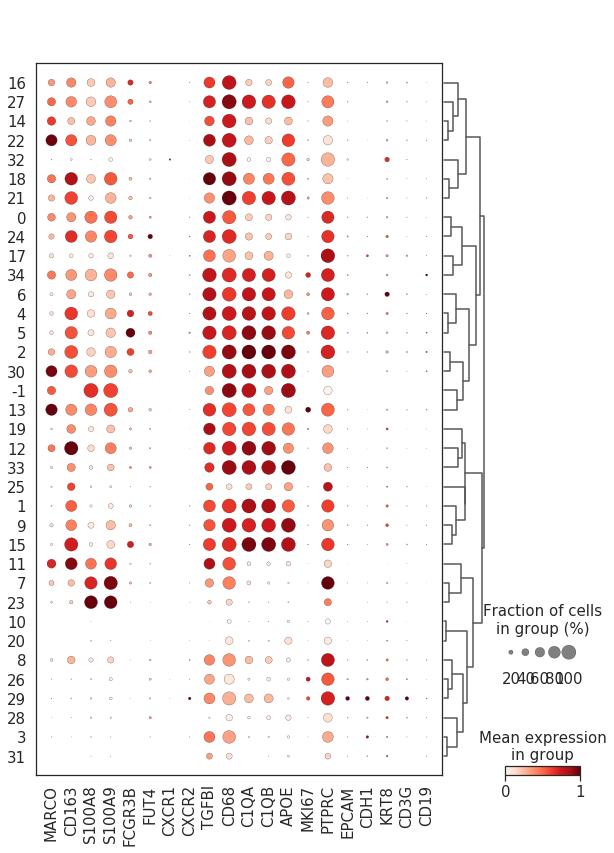

In [62]:
#dotplot
%matplotlib inline
pheno_heat = 'pheno_Mhq_k10'
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, ['MARCO', 'CD163','S100A8', 'S100A9', 'FCGR3B', 'FUT4','CXCR1','CXCR2', 'TGFBI','CD68','C1QA','C1QB','APOE','MKI67','PTPRC','EPCAM','CDH1','KRT8','CD3G','CD19'], groupby=pheno_heat, dendrogram=True, standard_scale='var')

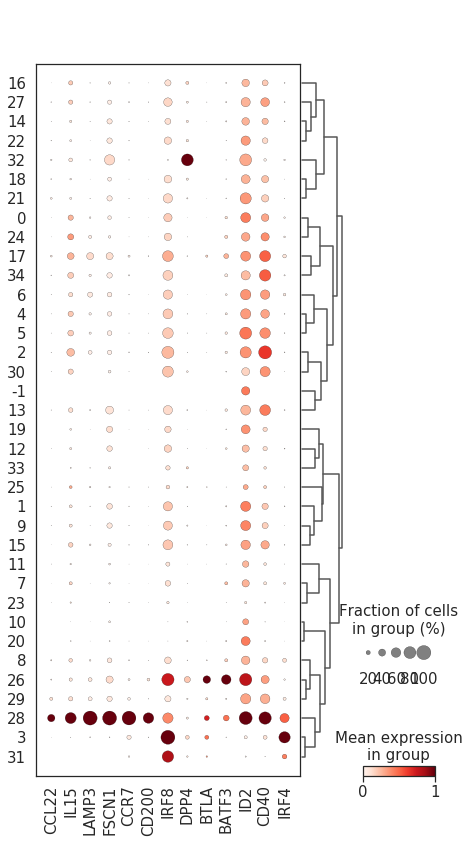

In [63]:
#dotplot
pheno_heat = 'pheno_Mhq_k10'
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, ['CCL22','IL15','LAMP3','FSCN1', 'CCR7', 'CD200', 'IRF8', 'DPP4', 'BTLA', 'BATF3', 'ID2', 'CD40', 'IRF4'], groupby=pheno_heat, dendrogram=True, standard_scale='var')

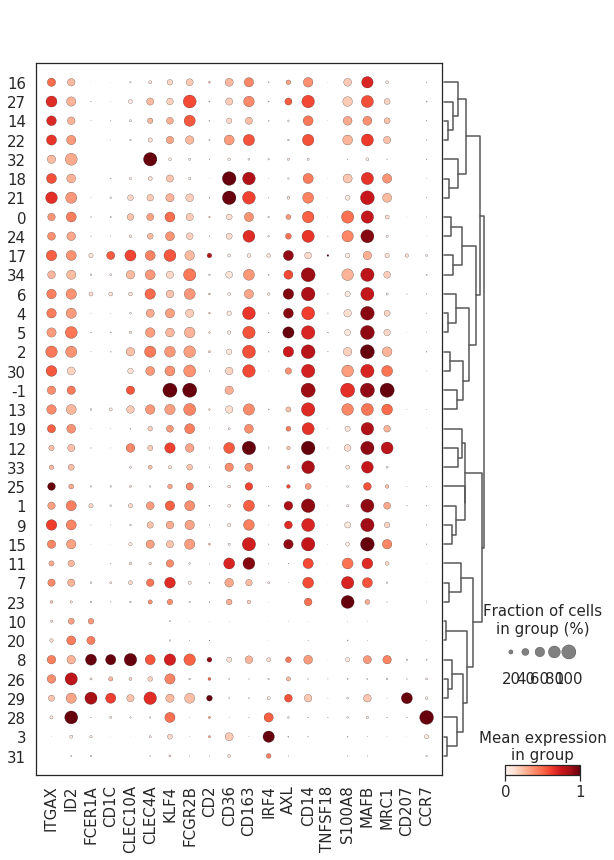

In [64]:
#dotplot
pheno_heat = 'pheno_Mhq_k10'
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, ['ITGAX','ID2','FCER1A','CD1C','CLEC10A','CLEC4A','KLF4','FCGR2B', 'CD2','CD36', 'CD163','IRF4', 'AXL', 'CD14','TNFSF18', 'S100A8', 'MAFB', 'MRC1','CD207','CCR7'], groupby=pheno_heat, dendrogram=True, standard_scale='var')

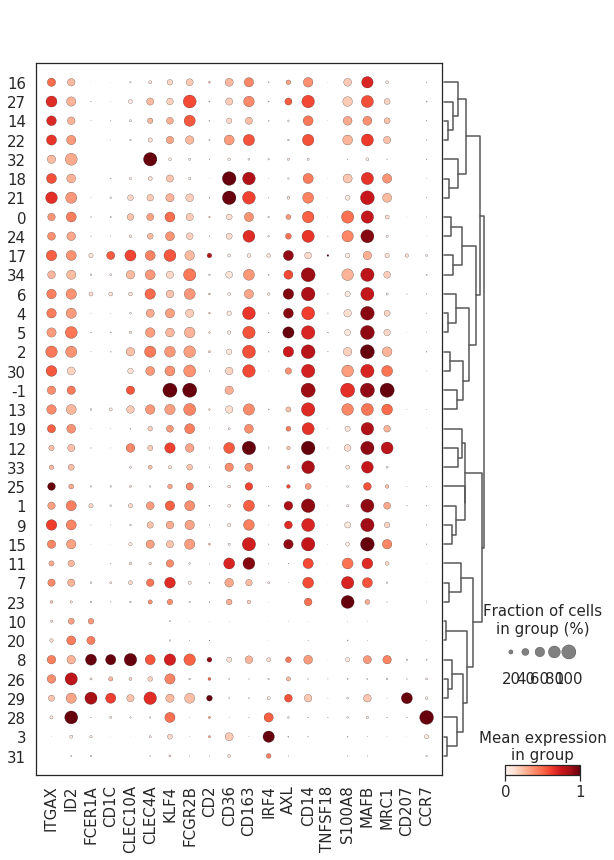

In [65]:
#dotplot
pheno_heat = 'pheno_Mhq_k10'
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, ['ITGAX','ID2','FCER1A','CD1C','CLEC10A','CLEC4A','KLF4','FCGR2B', 'CD2','CD36', 'CD163','IRF4', 'AXL', 'CD14','TNFSF18', 'S100A8', 'MAFB', 'MRC1','CD207','CCR7'], groupby=pheno_heat, dendrogram=True, standard_scale='var')

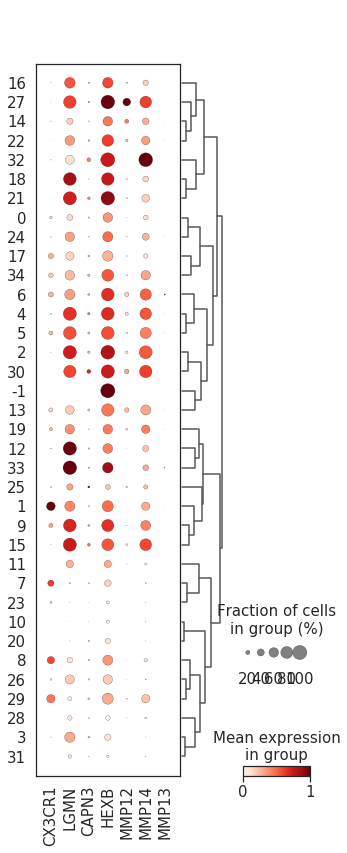

In [66]:
#dotplot
pheno_heat = 'pheno_Mhq_k10'
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, ['CX3CR1','LGMN','CAPN3','HEXB','MMP12','MMP14','MMP13'], groupby=pheno_heat, dendrogram=True, standard_scale='var')

In [83]:
# set parameters
pheno_overlap = 'pheno_Mhq_k20'
gene_number = 50

In [84]:
#calculate DEG
sc.tl.rank_genes_groups(adata, pheno_overlap, groups='all', reference='rest', n_genes=gene_number, copy=False, method='wilcoxon', corr_method='benjamini-hochberg', layer=None)

/home/wallet/miniconda3/envs/2021_Peer_SPADE_sample_data_exploration/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:393: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider using pd.concat instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/home/wallet/miniconda3/envs/2021_Peer_SPADE_sample_data_exploration/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:395: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider using pd.concat instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/home/wallet/miniconda3/envs/2021_Peer_SPADE_sample_data_exploration/lib/python3.8/site-packages/scanpy/tools/_rank

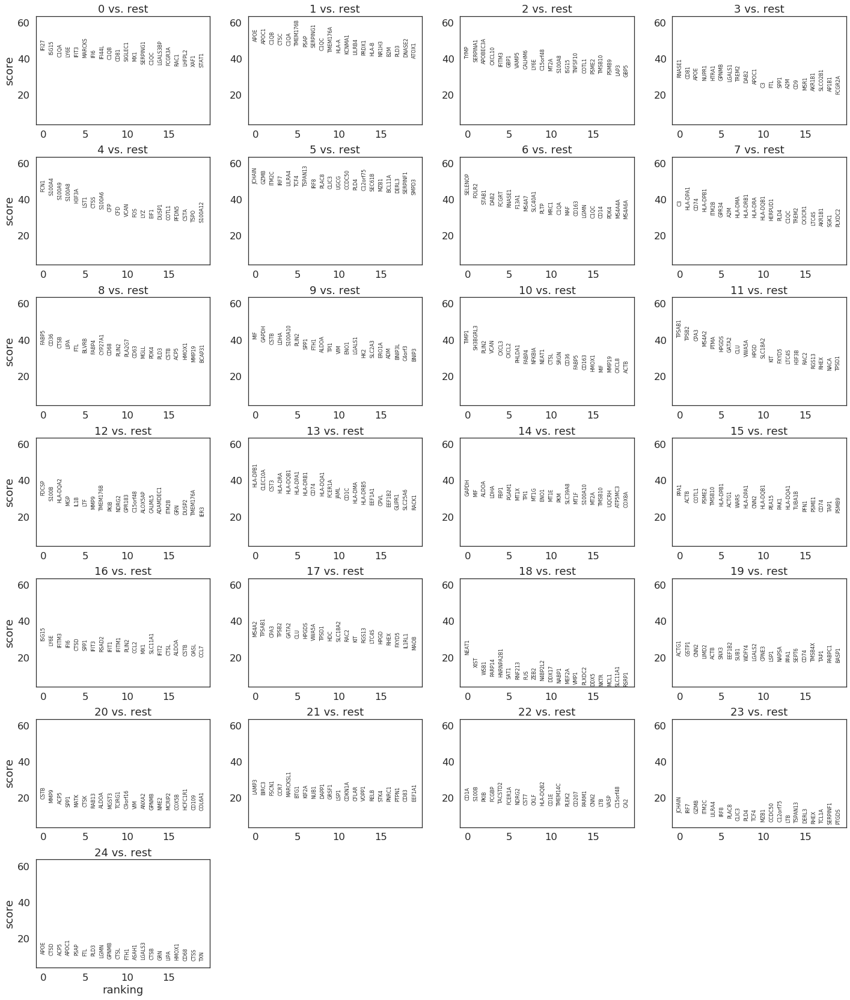

In [85]:
sc.pl.rank_genes_groups(adata, n_genes=20)

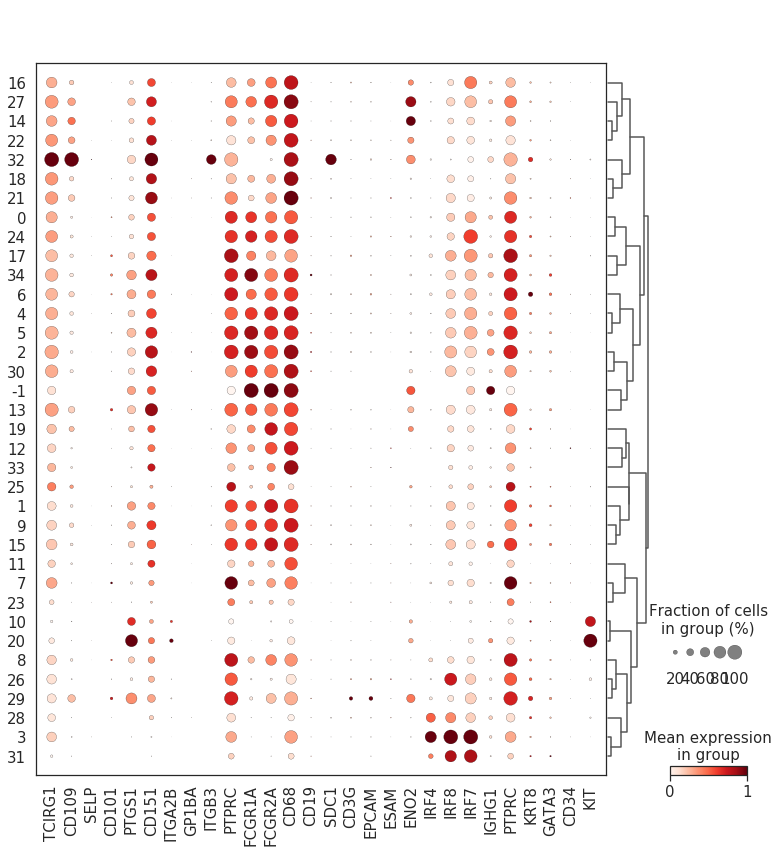

In [70]:
#dotplot
pheno_heat = 'pheno_Mhq_k10'
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, ['TCIRG1','CD109','SELP','CD101','PTGS1','CD151','ITGA2B','GP1BA','ITGB3','PTPRC','FCGR1A','FCGR2A','CD68','CD19','SDC1','CD3G','EPCAM','ESAM','ENO2','IRF4','IRF8','IRF7','IGHG1','PTPRC','KRT8','GATA3','CD34','KIT'], groupby=pheno_heat, dendrogram=True, standard_scale='var')

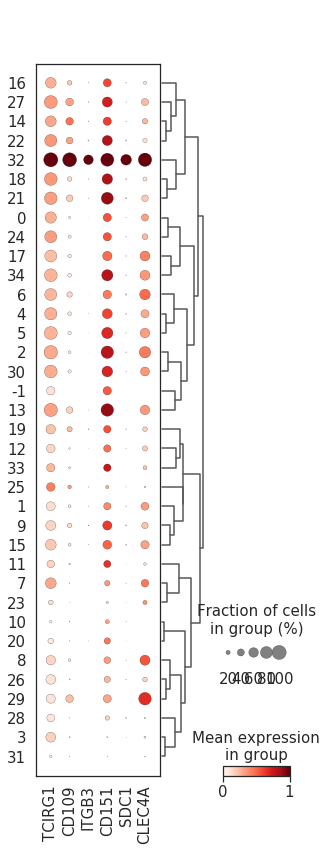

In [71]:
#dotplot
pheno_heat = 'pheno_Mhq_k10'
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, ['TCIRG1','CD109','ITGB3','CD151','SDC1','CLEC4A'], groupby=pheno_heat, dendrogram=True, standard_scale='var')

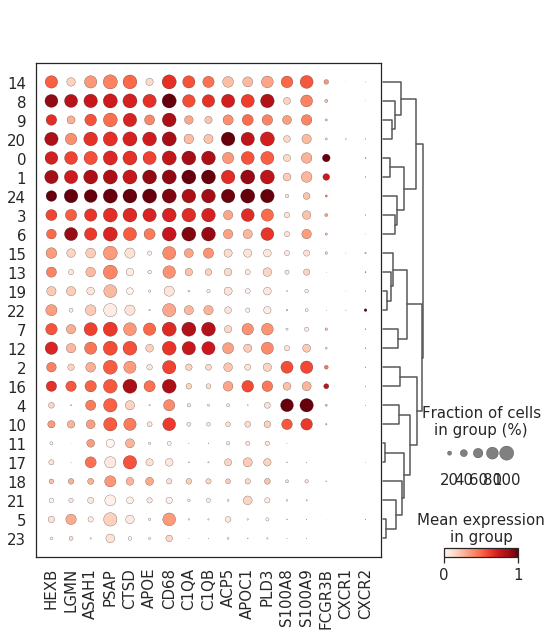

In [87]:
#dotplot
pheno_heat = 'pheno_Mhq_k20'
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, ['HEXB', 'LGMN', 'ASAH1', 'PSAP', 'CTSD', 'APOE', 'CD68', 'C1QA', 'C1QB','ACP5', 'APOC1', 'PLD3',
                      'S100A8', 'S100A9','FCGR3B', 'CXCR1', 'CXCR2'], groupby=pheno_heat, dendrogram=True, standard_scale='var')

## change label of cells where annotation has been refined by reclustering

In [89]:
pheno_heat = 'pheno_Mhq_k20'
clusters_to_change = 24

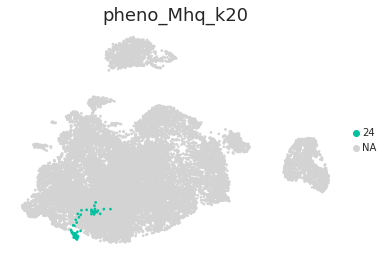

In [90]:
sc.pl.umap(adata, color = [pheno_heat],groups=[clusters_to_change],  layer = None, s = 30, palette=color_map_clusters_nogrey, legend_fontsize = 10,vmin=0)


In [91]:
#get cell barcodes
cells_label_change = list(adata[adata.obs[pheno_heat]==clusters_to_change].obs_names)
cells_label_change

/home/wallet/miniconda3/envs/2021_Peer_SPADE_sample_data_exploration/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2630: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


['JUQ024_AACCATGCAGTAAGAT-1',
 'JUQ024_CGTTGGGTCTGCAGTA-1',
 'JUQ025_AAGACCTAGTGGGTTG-1',
 'JUQ025_ACACCAAGTCTTCAAG-1',
 'JUQ025_ACGCCGACACACCGCA-1',
 'JUQ025_AGAGCGAAGCCAGTTT-1',
 'JUQ025_AGAGCGATCCGATATG-1',
 'JUQ025_ATCCGAACAACACCTA-1',
 'JUQ025_CACACTCGTTCCACTC-1',
 'JUQ025_CACAGGCCATAGAAAC-1',
 'JUQ025_CATCAGAAGCCTTGAT-1',
 'JUQ025_CGAGAAGGTCGAATCT-1',
 'JUQ025_CGATTGAGTCCGAAGA-1',
 'JUQ025_CGGACGTTCAGCACAT-1',
 'JUQ025_CTCCTAGGTGAAATCA-1',
 'JUQ025_GCTTGAATCAGAAATG-1',
 'JUQ025_GTGCAGCCATGCCTAA-1',
 'JUQ025_GTTCATTCAACTGCTA-1',
 'JUQ025_TCAGGTACAAAGGTGC-1',
 'JUQ025_TCATTTGTCAGCTCTC-1',
 'JUQ025_TCGCGAGCAGACAAAT-1',
 'JUQ025_TCGCGTTCAAGACGTG-1',
 'JUQ025_TCTGGAACAGTCGTGC-1',
 'JUQ025_TCTTCGGTCATGTCTT-1',
 'JUQ025_TGATTTCCACCCATTC-1',
 'JUQ027_ATTACTCAGGTGACCA-1',
 'JUQ047_ATAGACCCATATGGTC-1',
 'JUQ070_CCATGTCAGGAGTACC-1',
 'JUQ070_CTCATTAAGGCATGGT-1',
 'JUQ070_CTCATTAAGTCTTGCA-1',
 'JUQ070_GATGCTAGTTGGACCC-1',
 'JUQ070_TGCCAAAAGGGCTCTC-1',
 'JUQ090_CGTCACTTCCCAAGTA-1',
 'JUQ091_C

In [92]:
#update labels 
annotation_to_change = 'annotation_SPADE_2' #key for annoptation obs to change
keys = cells_label_change #cell barcodes to be changes
values = ['TAM_TRMac']*len(cells_label_change) #labels to add for these barcodes
new_label_dict = dict(zip(keys, values))
new_labels = [new_label_dict[x] if x in cells_label_change else 
              adata.obs.loc[x,annotation_to_change] for x in adata.obs_names]
adata.obs[annotation_to_change] = new_labels
adata.obs[annotation_to_change]

JUQ024_AAACCTGCAACAACCT-1    DC_AXLpos_ITGAXpos
JUQ024_AAACCTGGTCTCCACT-1                   pDC
JUQ024_AAACCTGTCAACGAAA-1              DC_cDC2A
JUQ024_AAACGGGCACAGAGGT-1                   TAM
JUQ024_AAATGCCAGCCTTGAT-1              DC_cDC2A
                                    ...        
JUQ124_TGCCCTATCAGGTAAA-1                   TAM
JUQ124_TGCGCAGAGGCAGGTT-1                 M-MDC
JUQ124_TTAGGACGTCTCTCGT-1                   TAM
JUQ124_TTAGTTCCATCCCACT-1                   TAM
JUQ124_TTTACTGCACGGTGTC-1                   TAM
Name: annotation_SPADE_2, Length: 16640, dtype: object

In [ ]:
sc.pl.umap(adata, color = ['batch'],  layer = None, s = 30, palette=color_map_clusters_nogrey, legend_fontsize = 10,vmin=0)
sc.pl.umap(adata, color = ['pheno_Mhq_k10'],  layer = None, s = 30, palette=color_map_clusters_nogrey, legend_fontsize = 10,vmin=0)
sc.pl.umap(adata, color = ['pheno_Mhq_k20'],  layer = None, s = 30, palette=color_map_clusters_nogrey, legend_fontsize = 10,vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_0'],  layer = None, s = 30, palette=color_map_clusters_nogrey, legend_fontsize = 10,vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_1'],  layer = None, s = 30, palette=color_map_clusters_nogrey, legend_fontsize = 10,vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_2'],  layer = None, s = 30, palette=color_map_clusters_nogrey, legend_fontsize = 10,vmin=0)

In [98]:
clusters_to_change = 32
change_into = 'TAM_MKlike'
annotation_to_change = 'annotation_SPADE_2' #key for annoptation obs to change
pheno_heat = 'pheno_Mhq_k10'

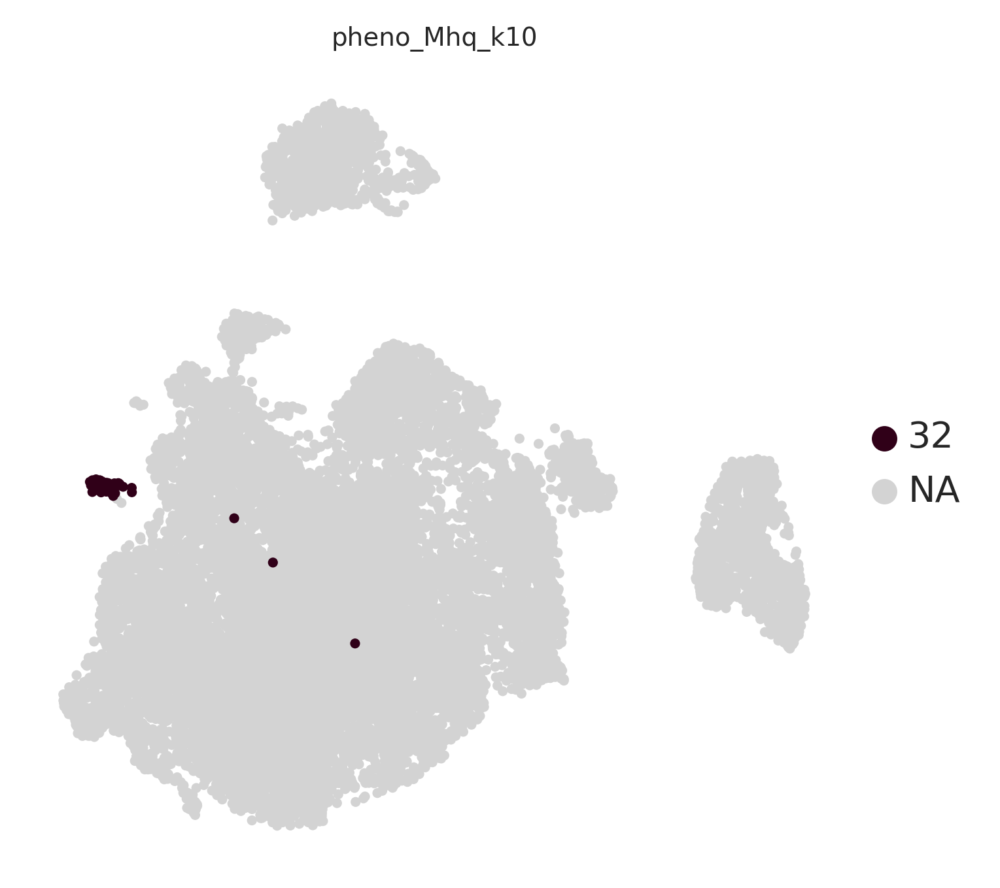

In [99]:
sc.pl.umap(adata, color = [pheno_heat],groups=[clusters_to_change],  layer = None, s = 30, palette=color_map_clusters_nogrey, legend_fontsize = 10,vmin=0)


In [100]:
#get cell barcodes
cells_label_change = list(adata[adata.obs[pheno_heat]==clusters_to_change].obs_names)
cells_label_change

/home/wallet/miniconda3/envs/2021_Peer_SPADE_sample_data_exploration/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2630: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


['JUQ024_CTGATCCAGATAGGAG-1',
 'JUQ024_TGCGTGGAGACGCACA-1',
 'JUQ026_CGCTATCAGATATACG-1',
 'JUQ026_GGACGTCTCGCTGATA-1',
 'JUQ026_TGACTAGCATATACCG-1',
 'JUQ036_ATGGGAGGTCTCACCT-1',
 'JUQ039_ATCATCTCAAGGTTTC-1',
 'JUQ048_ACGGCCATCGCGTTTC-1',
 'JUQ048_GTACTTTGTCGCTTCT-1',
 'JUQ048_TCTATTGCAAACCTAC-1',
 'JUQ049_CAGCTGGTCTGCTTGC-1',
 'JUQ064_GTATTCTTCTGGCGAC-1',
 'JUQ064_TGGCTGGCAATAACGA-1',
 'JUQ068_CGAACATGTCAAAGCG-1',
 'JUQ068_CTTGGCTTCTCCCTGA-1',
 'JUQ087_CGGACACTCTTTCCTC-1',
 'JUQ090_AAGCCGCGTAAATGAC-1',
 'JUQ090_AATCCAGCAAGCCCAC-1',
 'JUQ090_CGTGAGCTCTGAGTGT-1',
 'JUQ090_GTACTCCAGATATGGT-1',
 'JUQ090_GTAGTCAAGTGCGATG-1',
 'JUQ090_TAAGTGCGTACATCCA-1',
 'JUQ092_GCTGCAGAGCTAACAA-1',
 'JUQ092_TCGCGAGTCATGTCTT-1',
 'JUQ101_GCATGTAAGCTGAACG-1',
 'JUQ107_AACGTTGAGCGTTGCC-1',
 'JUQ107_AGCTTGACACAGGTTT-1',
 'JUQ107_ATGCGATCATTTCAGG-1',
 'JUQ107_CAGCCGACAACACCTA-1',
 'JUQ107_CATCCACAGATGGCGT-1',
 'JUQ107_GCCAAATAGTGTACGG-1',
 'JUQ107_TTGAACGTCCGGCACA-1',
 'JUQ031_AACACGTTCCTGCCAT-1',
 'JUQ031_A

In [101]:
#update labels 
keys = cells_label_change #cell barcodes to be changes
values = [change_into]*len(cells_label_change) #labels to add for these barcodes
new_label_dict = dict(zip(keys, values))
new_labels = [new_label_dict[x] if x in cells_label_change else 
              adata.obs.loc[x,annotation_to_change] for x in adata.obs_names]
adata.obs[annotation_to_change] = new_labels
adata.obs[annotation_to_change]

JUQ024_AAACCTGCAACAACCT-1    DC_AXLpos_ITGAXpos
JUQ024_AAACCTGGTCTCCACT-1                   pDC
JUQ024_AAACCTGTCAACGAAA-1              DC_cDC2A
JUQ024_AAACGGGCACAGAGGT-1                   TAM
JUQ024_AAATGCCAGCCTTGAT-1              DC_cDC2A
                                    ...        
JUQ124_TGCCCTATCAGGTAAA-1                   TAM
JUQ124_TGCGCAGAGGCAGGTT-1                 M-MDC
JUQ124_TTAGGACGTCTCTCGT-1                   TAM
JUQ124_TTAGTTCCATCCCACT-1                   TAM
JUQ124_TTTACTGCACGGTGTC-1                   TAM
Name: annotation_SPADE_2, Length: 16640, dtype: object

In [ ]:
sc.pl.umap(adata, color = ['annotation_SPADE_1'],layer='imputed',palette=color_map_clusters_nogrey, s = 30, legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_2'],layer='imputed',palette=color_map_clusters_nogrey, s = 30, legend_fontsize = 10, vmin=0)

In [103]:
adata.write(save_path)
print('AnnData object saved to:', save_path)

AnnData object saved to: /data/peer/wallet/Jupyter/2021_SPADE/2021_Bassez_BRCA/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_M_scran_plus_raw_obs_clustered_15k_hv_genes_annotate_211127_high-quality-cells.h5ad


## read data and plot

In [12]:
color_dict = subtype_color_dict 
adata_path = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_M_scran_plus_raw_obs_clustered_15k_hv_genes_annotate_211127_high-quality-cells.h5ad'


In [13]:
#read data
adata = sc.read(adata_path)

In [14]:
adata

AnnData object with n_obs × n_vars = 16640 × 19024
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k2

In [109]:
len(set(adata.obs['Bassez_patient_id']))

42

In [ ]:
sc.pl.umap(adata, color = ['pheno_Mhq_k10'],groups=[25],layer='imputed',palette=color_map_clusters_nogrey, s = 30, legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_1'],layer='imputed',palette=subtype_color_dict, s = 30, legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_2'],layer='imputed',palette=subtype_color_dict, s = 30, legend_fontsize = 10, vmin=0)

In [ ]:
sc.pl.tsne(adata, color = ['pheno_Mhq_k10'],groups=[25],layer='imputed',palette=color_map_clusters_nogrey, s = 30, legend_fontsize = 10, vmin=0)
sc.pl.tsne(adata, color = ['annotation_SPADE_1'],layer='imputed',palette=subtype_color_dict, s = 30, legend_fontsize = 10, vmin=0)
sc.pl.tsne(adata, color = ['annotation_SPADE_2'],layer='imputed',palette=subtype_color_dict, s = 30, legend_fontsize = 10, vmin=0)

In [ ]:
sc.pl.tsne(adata, color = ['pheno_Mhq_k30'], layer='imputed', palette=color_map_clusters_nogrey, 
           s = 30, legend_fontsize = 10, vmin=0)


In [30]:
adata_sub = adata[adata.obs['annotation_SPADE_1']=='MDC']

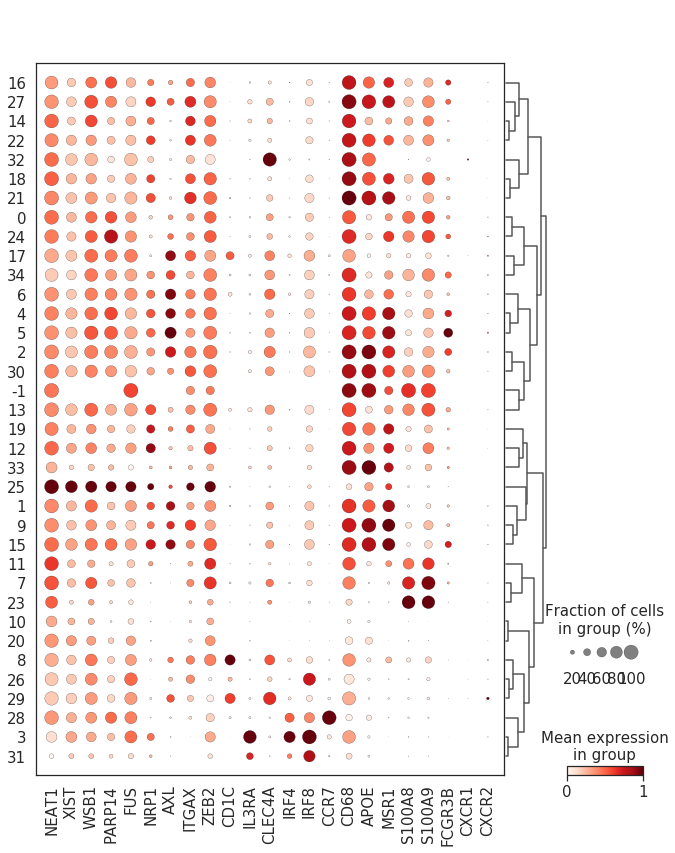

In [130]:
#dotplot
pheno_heat = 'pheno_Mhq_k10'
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, ['NEAT1','XIST','WSB1','PARP14','FUS','NRP1','AXL','ITGAX','ZEB2','CD1C', 'IL3RA', 'CLEC4A', 'IRF4', 'IRF8', 'CCR7','CD68','APOE','MSR1','S100A8', 'S100A9','FCGR3B', 'CXCR1', 'CXCR2'], groupby=pheno_heat, dendrogram=True, standard_scale='var')

In [113]:
# set parameters
pheno_overlap = 'pheno_Mhq_k10'
gene_number = 50

/home/wallet/miniconda3/envs/2021_Peer_SPADE_sample_data_exploration/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:393: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider using pd.concat instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/home/wallet/miniconda3/envs/2021_Peer_SPADE_sample_data_exploration/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:395: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider using pd.concat instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/home/wallet/miniconda3/envs/2021_Peer_SPADE_sample_data_exploration/lib/python3.8/site-packages/scanpy/tools/_rank

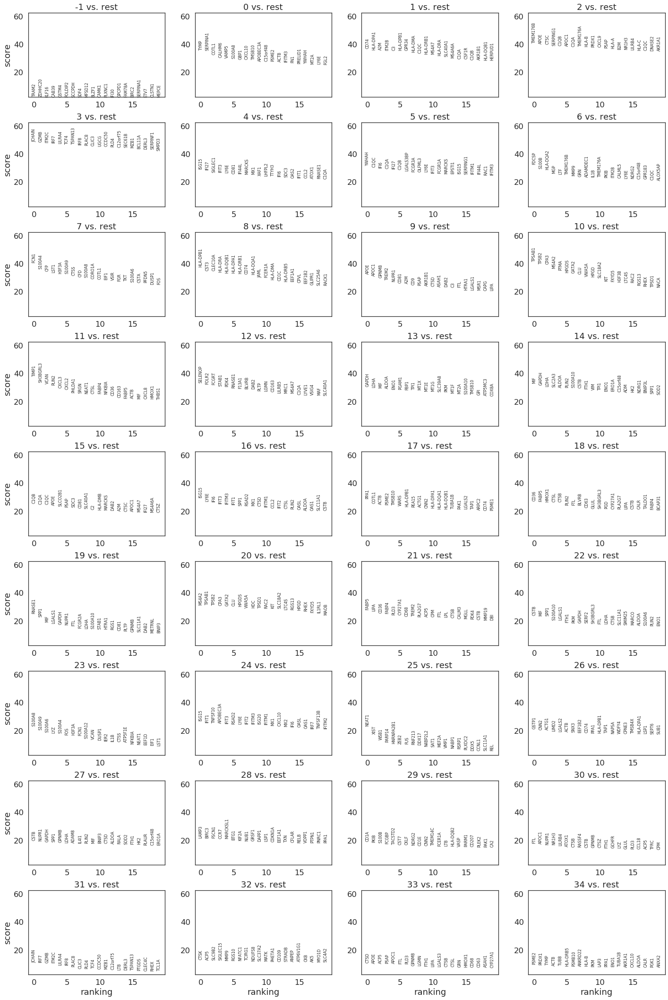

In [114]:
#calculate DEG
sc.tl.rank_genes_groups(adata, pheno_overlap, groups='all', reference='rest', n_genes=gene_number, copy=False, method='wilcoxon', corr_method='benjamini-hochberg', layer=None)
sc.pl.rank_genes_groups(adata, n_genes=20)

In [234]:
#create dataframe with markers of interest
#genes_of_interest = ['TCIRG1', 'CD109', 'CD151', 'ITGB3', 'SIGLEC15','DPP4','SDC1']
genes_of_interest=['FCER1A','CD1C','CLEC10A','CLEC4A','KLF4','FCGR2B']
clustering = 'annotation_SPADE_2'

cov_df_list =[]
cov_df_name_list =[]

for i in set(adata.obs[clustering]):
    adata_subset = adata[adata.obs['annotation_SPADE_2']==i]
    adata_subset = adata_subset[:,genes_of_interest]
    adata_df = pd.DataFrame(adata_subset.X, columns=adata_subset.var_names,index=adata_subset.obs_names)
    sns.set(font_scale=3)
    corr_out = corr_cov_matrix_cluster(adata_df, markers=genes_of_interest, metric='covariance',clustering_method = 'average', linkage_distance=1.6)
    cov_df_list.append(corr_out)
    cov_df_name_list.append(i)

output list order: dataframe, hierarchical flat clusters, row linkage, column linkage
output list order: dataframe, hierarchical flat clusters, row linkage, column linkage
output list order: dataframe, hierarchical flat clusters, row linkage, column linkage
output list order: dataframe, hierarchical flat clusters, row linkage, column linkage
output list order: dataframe, hierarchical flat clusters, row linkage, column linkage
output list order: dataframe, hierarchical flat clusters, row linkage, column linkage
output list order: dataframe, hierarchical flat clusters, row linkage, column linkage
output list order: dataframe, hierarchical flat clusters, row linkage, column linkage
output list order: dataframe, hierarchical flat clusters, row linkage, column linkage
output list order: dataframe, hierarchical flat clusters, row linkage, column linkage
output list order: dataframe, hierarchical flat clusters, row linkage, column linkage
output list order: dataframe, hierarchical flat cluste

In [ ]:
for h,i in enumerate(cov_df_list):
    print(cov_df_name_list[h])
    plot_cov_clustermap(i,color_map_clusters_nogrey)

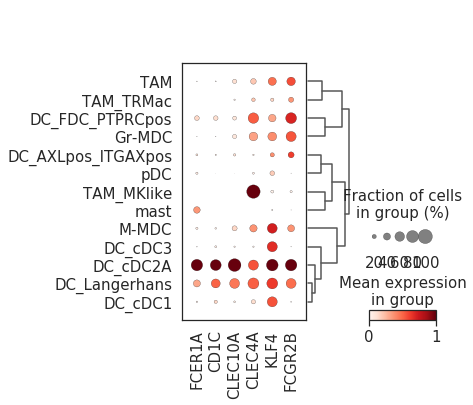

In [236]:
#dotplot
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=clustering)
sc.pl.dotplot(adata, genes_of_interest, groupby=clustering, dendrogram=True, standard_scale='var')

## B cell

In [1]:
# Annotate cells

#define adata, clusters and marker genes for heatmaps here
adata_path = '/data/peer/wallet/Jupyter/2021_SPADE/2021_Bassez_BRCA/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_B_scran_plus_raw_obs_clustered_7500k_hv_genes.h5ad'
adata_save_path = '/data/peer/wallet/Jupyter/2021_SPADE/2021_Bassez_BRCA/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_B_scran_plus_raw_obs_clustered_7500k_hv_genes_annotated_211208.h5ad'
pheno_annotate = 'pheno_var_B_k40'
prefix = 'B_'

#mappings

subtype_0_dict = {'B_0': 'B',
                 'B_1': 'B',
                 'B_2': 'B',
                 'B_3': 'B',
                 'B_4': 'B',
                 'B_5': 'B',
                 'B_6': 'B',
                 'B_7': 'B',
                 'B_8': 'B',
                 'B_9': 'B',
                 'B_10': 'B',
                 'B_11': 'B',
                 'B_12': 'B',
                 'B_13': 'B',
                 'B_14': 'B',
                 'B_15': 'B'}

subtype_1_dict = {'B_0': 'B_memory',
                 'B_1': 'B_memory',
                 'B_2': 'B_memory',
                 'B_3': 'B_naive',
                 'B_4': 'B_naive',
                 'B_5': 'plasma',
                 'B_6': 'B_memory',
                 'B_7': 'plasma',
                 'B_8': 'plasma',
                 'B_9': 'plasma',
                 'B_10': 'B_GC',
                 'B_11': 'plasma',
                 'B_12': 'plasma',
                 'B_13': 'plasma',
                 'B_14': 'plasma',
                 'B_15': 'plasma'}


subtype_2_dict = {'B_0': 'B_memory_switched',
                 'B_1': 'B_memory_switched',
                 'B_2': 'B_memory_switched',
                 'B_3': 'B_naive',
                 'B_4': 'B_naive',
                 'B_5': 'plasma_IgA',
                 'B_6': 'B_memory_double_neg',
                 'B_7': 'plasma_IgG',
                 'B_8': 'plasma_IgG',
                 'B_9': 'plasma_IgG',
                 'B_10': 'B_GC_proliferating',
                 'B_11': 'plasmablast',
                 'B_12': 'plasma_IgG',
                 'B_13': 'plasma_IgG_Be1',
                 'B_14': 'plasma_IgG',
                 'B_15': 'plasma_IgG'}


In [46]:
#Annotate!

adata = sc.read(adata_path)

#create unique subset cluster names to later merge with in one .obs column with the other subsets (B, M..)
pheno_k10_subset_list = [i+j for i,j in zip(len(adata.obs[pheno_annotate])*[prefix], list(map(str, adata.obs[pheno_annotate])))]

#add to .obs element
adata.obs['pheno_annotate'] = pheno_k10_subset_list



#subtype_3_dict =   'M_12':'M_mem_switched_IgA_immature_plasma'

#map with dictionary

adata.obs['annotation_SPADE_0'] = pd.Categorical(adata.obs['pheno_annotate'].map(subtype_0_dict))
adata.obs['annotation_SPADE_1'] = pd.Categorical(adata.obs['pheno_annotate'].map(subtype_1_dict))
adata.obs['annotation_SPADE_2'] = pd.Categorical(adata.obs['pheno_annotate'].map(subtype_2_dict))

In [47]:
adata.varm['PCs'].shape

(17156, 10)

In [48]:
adata

AnnData object with n_obs × n_vars = 11767 × 17156
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k2

... storing 'pheno_annotate' as categorical


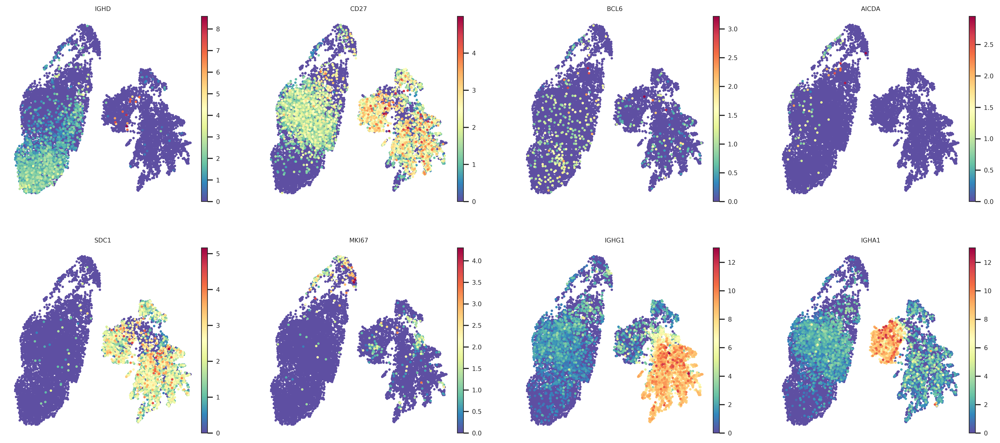

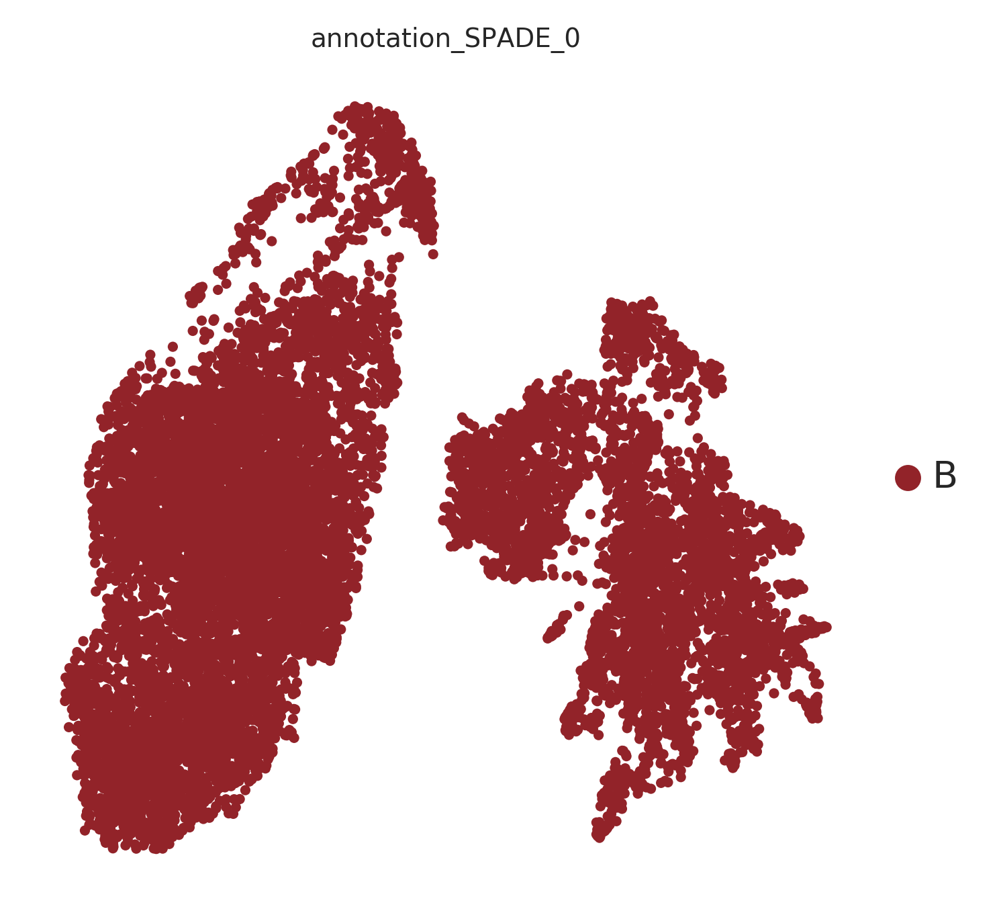

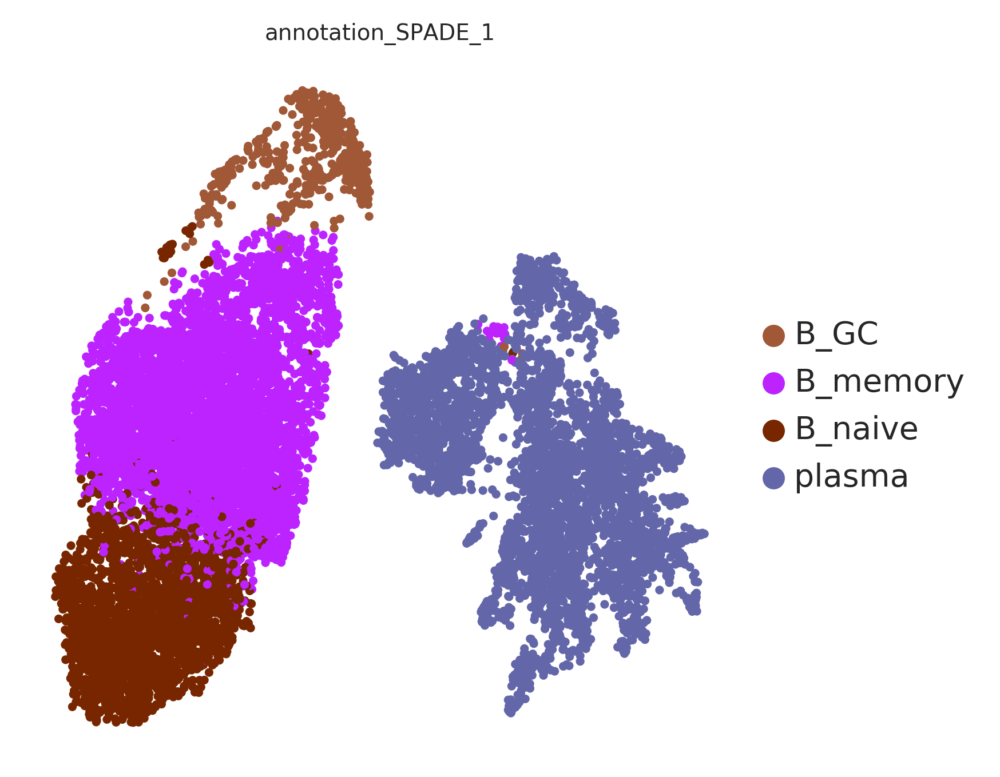

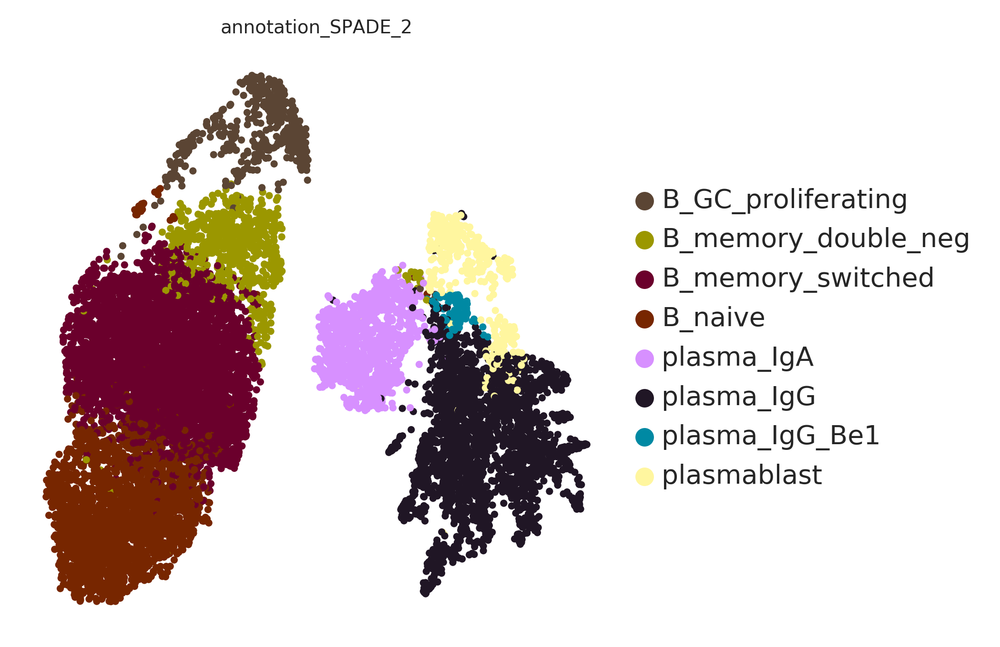

In [49]:
sc.pl.umap(adata, color = ['IGHD','CD27','BCL6','AICDA','SDC1','MKI67','IGHG1','IGHA1'],  layer = None, s = 30, cmap='Spectral_r', legend_fontsize = 10,vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_0'],  layer = None, s = 30, palette=subtype_color_dict, legend_fontsize = 10,vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_1'],  layer = None, s = 30, palette=subtype_color_dict, legend_fontsize = 10,vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_2'],  layer = None, s = 30, palette=subtype_color_dict, legend_fontsize = 10,vmin=0)

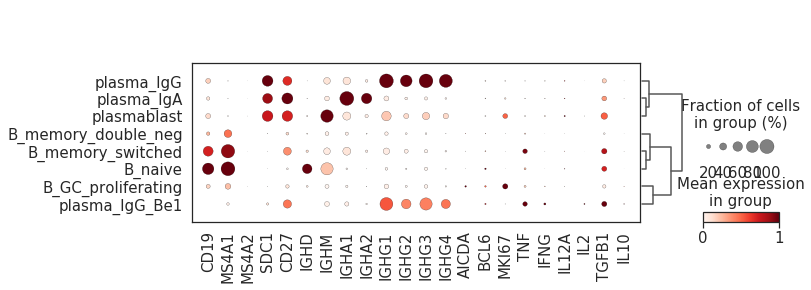

In [50]:
#dotplot
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby='annotation_SPADE_2')
sc.pl.dotplot(adata, ['CD19','MS4A1','MS4A2','SDC1','CD27','IGHD','IGHM','IGHA1','IGHA2','IGHG1', 'IGHG2',
                      'IGHG3','IGHG4','AICDA', 'BCL6','MKI67','TNF','IFNG','IL12A','IL2','TGFB1','IL10'], groupby='annotation_SPADE_2', dendrogram=True, standard_scale='var')

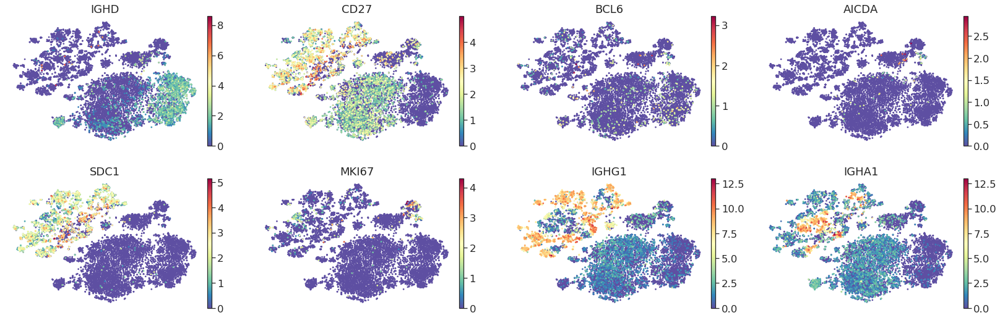

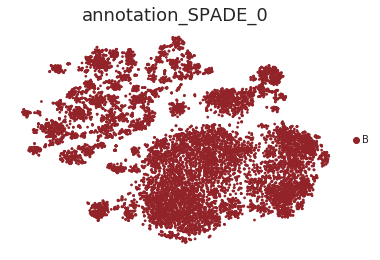

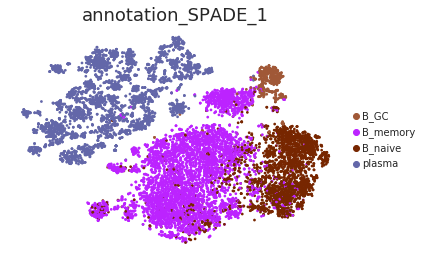

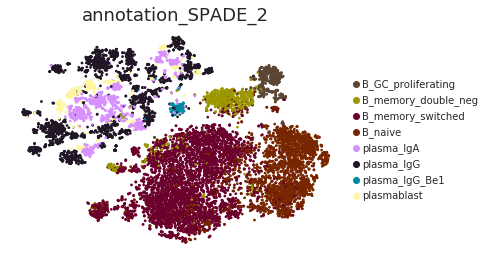

In [51]:
sc.pl.tsne(adata, color = ['IGHD','CD27','BCL6','AICDA','SDC1','MKI67','IGHG1','IGHA1'],  layer = None, s = 30, cmap='Spectral_r', legend_fontsize = 10,vmin=0)
sc.pl.tsne(adata, color = ['annotation_SPADE_0'],  layer = None, s = 30, palette=subtype_color_dict, legend_fontsize = 10,vmin=0)
sc.pl.tsne(adata, color = ['annotation_SPADE_1'],  layer = None, s = 30, palette=subtype_color_dict, legend_fontsize = 10,vmin=0)
sc.pl.tsne(adata, color = ['annotation_SPADE_2'],  layer = None, s = 30, palette=subtype_color_dict, legend_fontsize = 10,vmin=0)

In [ ]:
sc.pl.umap(adata, color = ['IGHD','CD27','BCL6','AICDA','SDC1','MKI67','IGHG1','IGHA1'],  layer = 'imputed', s = 30, cmap='Spectral_r', legend_fontsize = 10,vmin=0)


In [53]:
adata.write(adata_save_path)
print('AnnData object saved to:', adata_save_path)

AnnData object saved to: /data/peer/wallet/Jupyter/2021_SPADE/2021_Bassez_BRCA/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_B_scran_plus_raw_obs_clustered_7500k_hv_genes_annotated_211208.h5ad


## map annotations to anndata scran normalized on all samples and raw anndata element

In [16]:

adata_path = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_raw_filtered_clustered_drops_annotated_nodrops_log1p_clustered_leukocytes_scran_annotated_clustered_imputed_hvgenes_andmarker_15000_clustered_imputed_v2_210501.h5ad'#can be the same as input adata bc will be appended
#adata_raw_path = 
adata_save_path = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_raw_filtered_clustered_drops_annotated_nodrops_log1p_clustered_leukocytes_scran_annotated_clustered_imputed_hvgenes_andmarker_15000_clustered_imputed_v2_210501_annotated_211208.h5ad'#can be the same as input adata bc will be appended

#annotations
adata_B_path = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_B_scran_plus_raw_obs_clustered_7500k_hv_genes_annotated_211208.h5ad'
adata_M_path = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_M_scran_plus_raw_obs_clustered_15k_hv_genes_annotate_211127_high-quality-cells.h5ad'
adata_TNK_path = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_TNK_scran_plus_raw_obs_7500_hv_genes_annotated_211208.h5ad'


adata_paths = [adata_B_path, adata_M_path, adata_TNK_path] #order matters! DC after M!

make_raw= False


In [10]:
#load adata
adata = sc.read(adata_path)
adata_annotations = []

for i in adata_paths:
    adata_subset = sc.read(i)
    adata_annotations.append(adata_subset)
    del adata_subset

adata.obs_names #check whether format is barcode_sampleid

Index(['JUQ024_AAACCTGCAACAACCT-1', 'JUQ024_AAACCTGCAAGAAGAG-1',
       'JUQ024_AAACCTGGTCTCCACT-1', 'JUQ024_AAACCTGTCAACGAAA-1',
       'JUQ024_AAACGGGCACAGAGGT-1', 'JUQ024_AAACGGGTCCGAACGC-1',
       'JUQ024_AAACGGGTCGTAGGAG-1', 'JUQ024_AAAGATGAGCAGGCTA-1',
       'JUQ024_AAAGATGCAACTGCTA-1', 'JUQ024_AAAGATGCAAGCCGTC-1',
       ...
       'JUQ124_TTCGAAGCAGTCGTGC-1', 'JUQ124_TTCTACAAGCTATGCT-1',
       'JUQ124_TTCTCCTGTACCAGTT-1', 'JUQ124_TTCTCCTGTACCGTAT-1',
       'JUQ124_TTCTTAGGTGGTTTCA-1', 'JUQ124_TTCTTAGTCACCATAG-1',
       'JUQ124_TTTACTGCACCAGATT-1', 'JUQ124_TTTACTGCACGGTGTC-1',
       'JUQ124_TTTACTGGTAGCTAAA-1', 'JUQ124_TTTATGCAGCTAGTCT-1'],
      dtype='object', length=105773)

In [13]:
if make_raw == True:
    adata_raw = sc.read(adata_raw_path)
    adata_raw.obs['index'] = adata_raw.obs_names
    adata_raw.obs_names = adata_raw.obs['index'].str.cat(others=adata_raw.obs['sample_id'],sep='-')
    adata_raw_subset = adata_raw[adata.obs_names, adata.var_names]
    adata.X = adata_raw_subset.X

In [15]:
#retrieve annotations from .obs element and convert into dict

annotation_subtypes_1 = []
annotation_subtypes_2 = []
annotation_subtypes_3 = []
annotation_subtypes_0 = []

for i in adata_annotations:
    annotation_subtypes_1.append(i.obs['annotation_SPADE_0'])
    annotation_subtypes_2.append(i.obs['annotation_SPADE_1'])
    annotation_subtypes_3.append(i.obs['annotation_SPADE_2'])
    annotation_subtypes_0.append(i.obs['pheno_annotate'])
    
annotation_subtype_dicts_1 = []

for i in annotation_subtypes_1:
    annotation_subtype_1_dict = i.to_dict()
    annotation_subtype_dicts_1.append(annotation_subtype_1_dict)

annotation_subtype_dicts_2 = []
    
for i in annotation_subtypes_2:
    annotation_subtype_2_dict = i.to_dict()
    annotation_subtype_dicts_2.append(annotation_subtype_2_dict)
    
    
annotation_subtype_dicts_3 = []
    
for i in annotation_subtypes_3:
    annotation_subtype_3_dict = i.to_dict()
    annotation_subtype_dicts_3.append(annotation_subtype_3_dict)
    
annotation_subtype_dicts_0 = []
    
for i in annotation_subtypes_0:
    annotation_subtype_0_dict = i.to_dict()
    annotation_subtype_dicts_0.append(annotation_subtype_0_dict)

In [16]:
#concatenate dictionaries order matters! sutype 1

annotation_subtype_dict_1 = {}

for i in annotation_subtype_dicts_1:
    annotation_subtype_dict_1.update(i)
    
    
annotation_subtype_dict_2 = {}

for i in annotation_subtype_dicts_2:
    annotation_subtype_dict_2.update(i)
        
annotation_subtype_dict_3 = {}

for i in annotation_subtype_dicts_3:
    annotation_subtype_dict_3.update(i)   
    
annotation_subtype_dict_0 = {}

for i in annotation_subtype_dicts_0:
    annotation_subtype_dict_0.update(i)  

In [17]:
adata.obs['annotation_SPADE_0'] = adata.obs_names.map(annotation_subtype_dict_1)
adata.obs['annotation_SPADE_1'] = adata.obs_names.map(annotation_subtype_dict_2)
adata.obs['annotation_SPADE_2'] = adata.obs_names.map(annotation_subtype_dict_3)
adata.obs['pheno_annotate'] = adata.obs_names.map(annotation_subtype_dict_0)

In [18]:
print('mapped annotations level 1:', set(adata.obs['annotation_SPADE_0']))
print('mapped annotations level 2:', set(adata.obs['annotation_SPADE_1']))
print('mapped annotations level 2:', set(adata.obs['annotation_SPADE_2']))
print('mapped pheno for annotations:', set(adata.obs['pheno_annotate']))
print('cells lost during rescran of subsets:', len(adata[~adata.obs['annotation_SPADE_0'].isin(list(set(annotation_subtype_dict_1.values())))]))
print('cells lost during rescran of subsets:', len(adata[~adata.obs['annotation_SPADE_1'].isin(list(set(annotation_subtype_dict_2.values())))]))
print('cells lost during rescran of subsets:', len(adata[~adata.obs['annotation_SPADE_2'].isin(list(set(annotation_subtype_dict_2.values())))]))
print('cells lost during rescran of subsets:', len(adata[~adata.obs['pheno_annotate'].isin(list(set(annotation_subtype_dict_0.values())))]))
print('cells lost during rescran of subsets:', 100*(len(adata[~adata.obs['pheno_annotate'].isin(list(set(annotation_subtype_dict_0.values())))])/len(adata.obs_names)),'%')

mapped annotations level 1: {nan, 'B', 'TNK', 'M'}
mapped annotations level 2: {nan, 'CD4_T', 'MDC', 'CD8_T', 'B_GC', 'pDC', 'plasma', 'Treg', 'DC', 'NK', 'mast', 'gdT', 'B_naive', 'ILC3', 'B_memory'}
mapped annotations level 2: {nan, 'M-MDC', 'B_memory_double_neg', 'DC_cDC2A', 'Gr-MDC', 'DC_FDC_PTPRCpos', 'CD8_T_TRM_nonexhausted', 'B_memory_switched', 'mast', 'CD8_T_KLRG1pos_effector_preexhausted', 'DC_cDC1', 'CD8_T_naive', 'pDC', 'CD4_T_TH1_proliferating', 'CD8_T_TEM_effector_exhausted-progenitor', 'NK_CD56dim', 'plasma_IgG_Be1', 'B_naive', 'CD8_T_TRM_exhausted', 'CD4_T_TH1', 'CD8_T_TRM_exhausted_proliferating', 'plasmablast', 'Treg', 'NK_CD56bright', 'gdT', 'CD8_T_KLRG1pos_effector_nonexhausted', 'CD4_T_naive_low_libsize', 'B_GC_proliferating', 'DC_cDC3', 'plasma_IgA', 'CD4_T_naive', 'DC_AXLpos_ITGAXpos', 'DC_Langerhans', 'TAM_TRMac', 'TAM', 'TAM_MKlike', 'plasma_IgG', 'ILC3'}
mapped pheno for annotations: {'M_14', nan, 'TNK_20', 'M_10', 'M_1', 'B_6', 'B_7', 'B_9', 'M_3', 'M_12', 'B

/home/wallet/miniconda3/envs/2021_Peer_SPADE_sample_data_exploration/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2630: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


cells lost during rescran of subsets: 92320
cells lost during rescran of subsets: 7910
cells lost during rescran of subsets: 7.478278955877209 %


In [19]:
#annotate low libsize cells detected in clustering of subsets

low_quality_clusters = []

adata.obs['low_quality_cell'] = pd.Categorical(adata.obs['pheno_annotate'].isin(low_quality_clusters))

... storing 'annotation_SPADE_0' as categorical
... storing 'annotation_SPADE_1' as categorical
... storing 'annotation_SPADE_2' as categorical
... storing 'pheno_annotate' as categorical


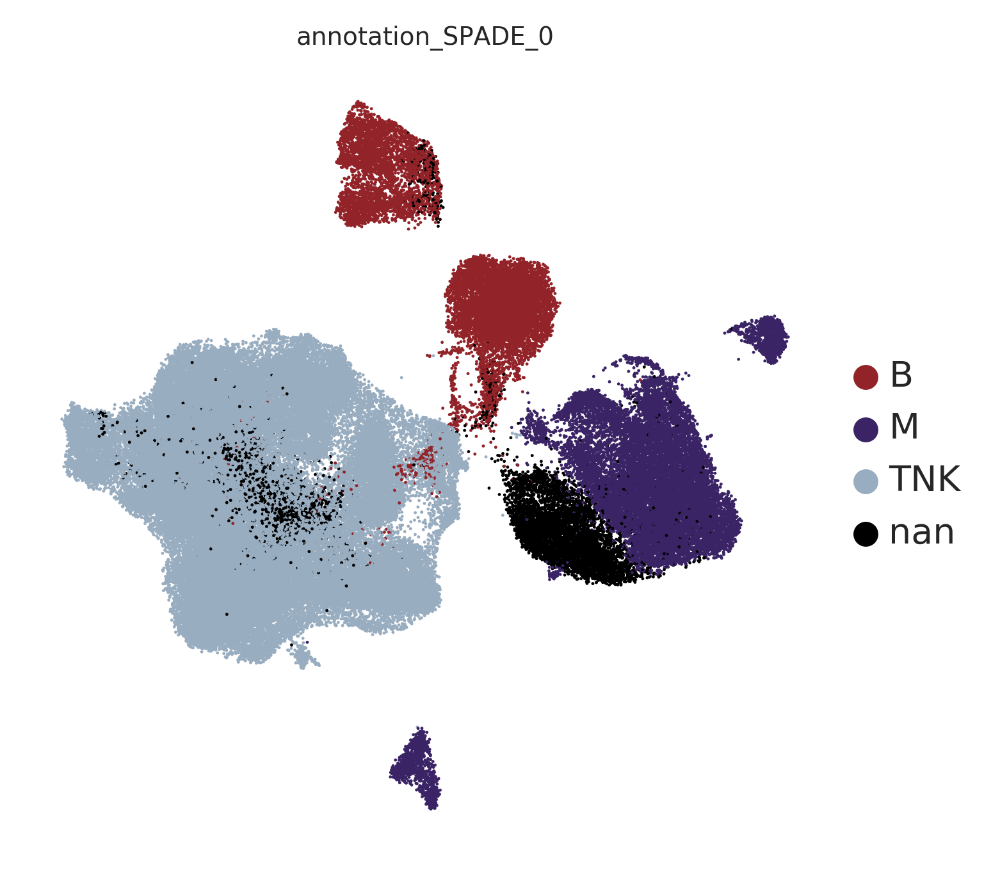

In [20]:
sc.pl.umap(adata, color = ['annotation_SPADE_0'], s = 3, palette=subtype_color_dict, legend_fontsize = 10, vmin=0)


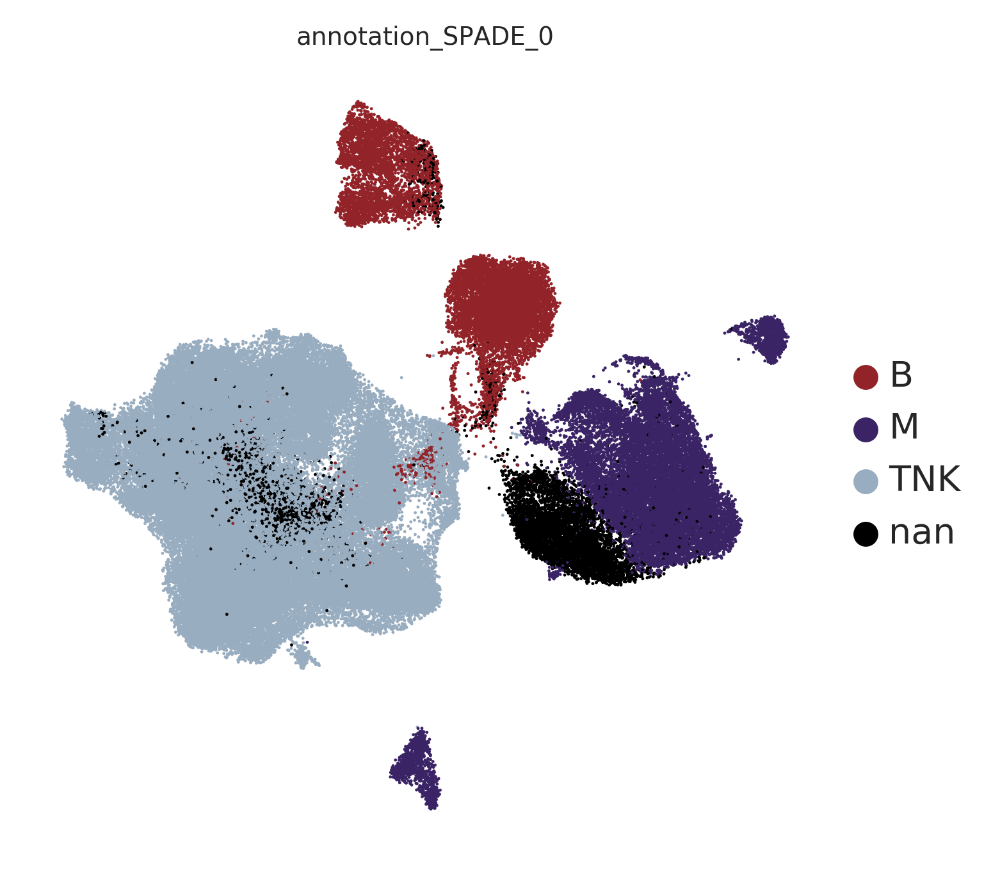

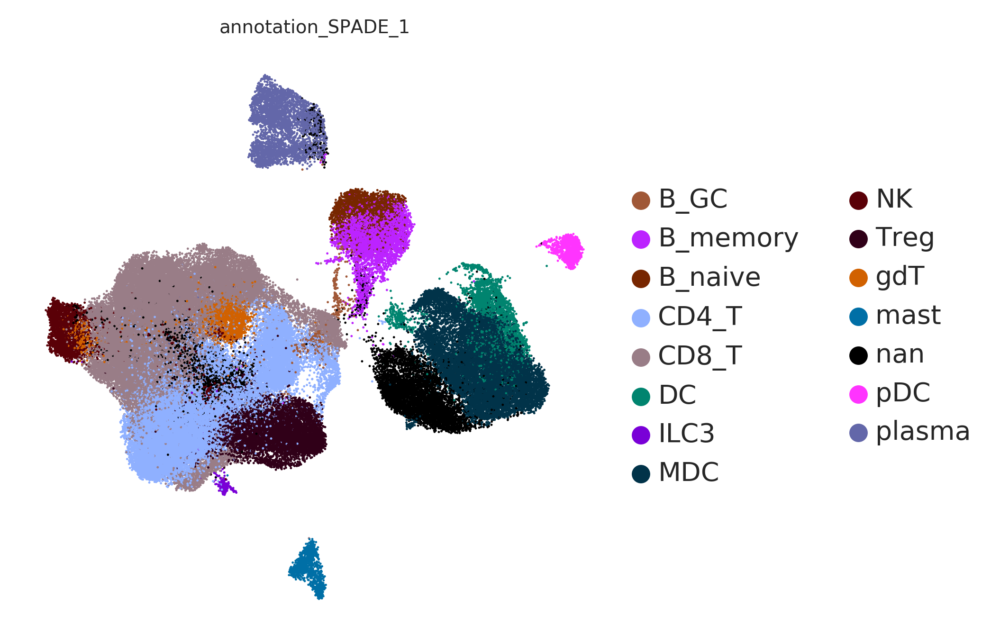

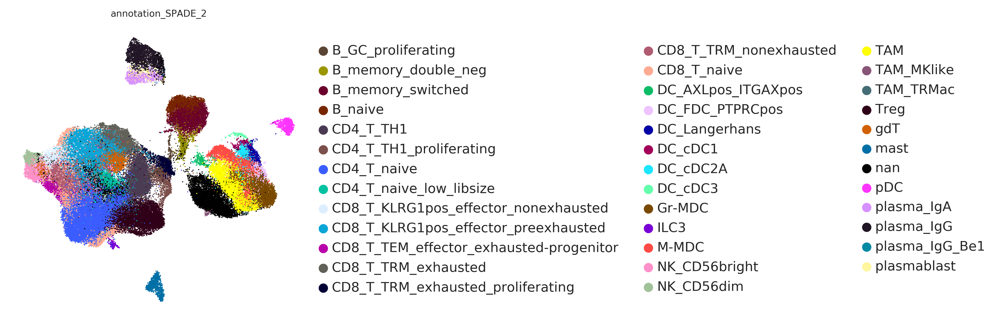

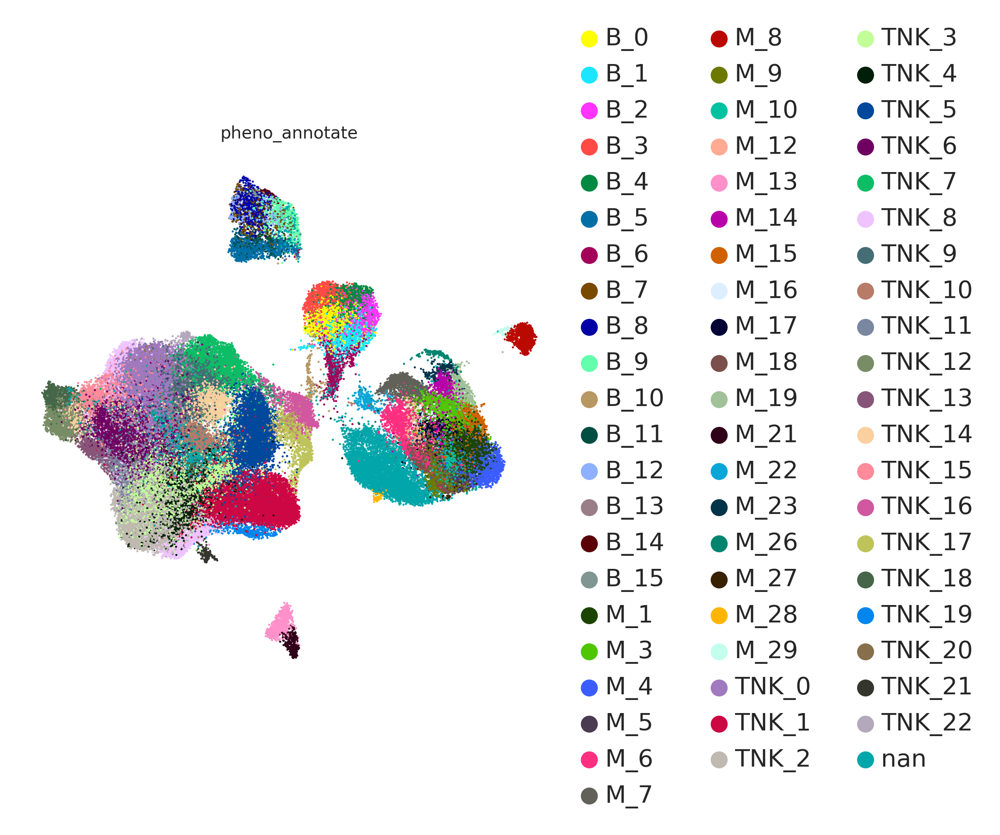

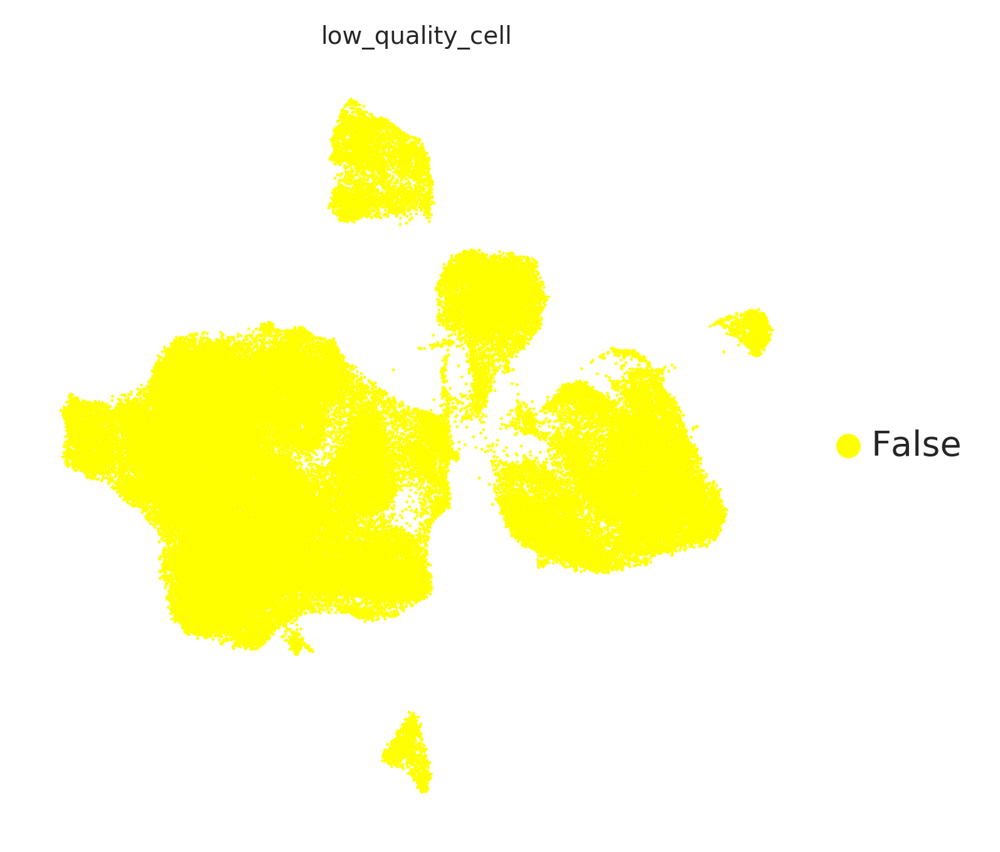

In [21]:
sc.pl.umap(adata, color = ['annotation_SPADE_0'], s = 3, palette=subtype_color_dict, legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_1'], s = 3, palette=subtype_color_dict, legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_2'], s = 3, palette=subtype_color_dict, legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['pheno_annotate'], s = 3, palette=color_map_clusters_nogrey, legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['low_quality_cell'], s = 3, palette=color_map_clusters_nogrey, legend_fontsize = 10, vmin=0)

In [22]:
adata

AnnData object with n_obs × n_vars = 105773 × 19984
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k

## recalculate embedding

In [23]:
#remove low quality nan cells
adata = adata[adata.obs['annotation_SPADE_1']!='nan']

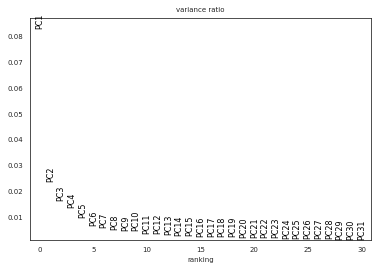

In [24]:
#remove low quality nan cells
adata = adata[adata.obs['annotation_SPADE_1']!='nan']#remove low quality nan cells
adata = adata[adata.obs['annotation_SPADE_1']!='nan']#PCA
%matplotlib inline

sc.tl.pca(adata, svd_solver='arpack',n_comps=100) 
sc.pl.pca_variance_ratio(adata,log=False)

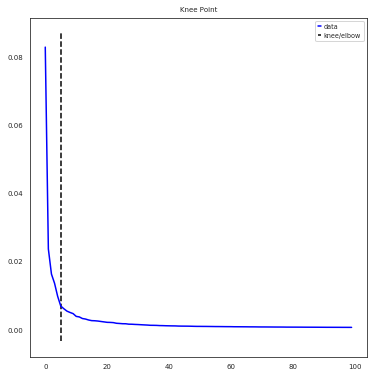

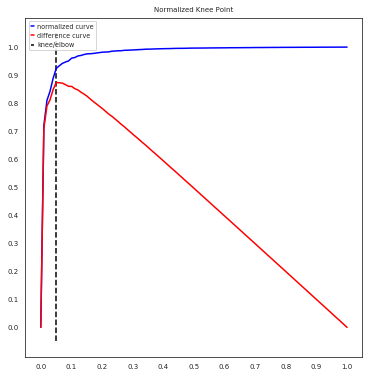

Kneepoint happens at PC: 5
5 PC explain 14.606849266891608 % of variance


In [25]:
a = adata.copy()# PCs kneepoint
x = [i for i in range(len(a.uns["pca"]["variance_ratio"]))]
y = list(a.uns["pca"]["variance_ratio"])
kneedle = KneeLocator(x,
                      y,
                      S=1,
                      curve='convex',
                      direction='decreasing',
                      online=False)
kn_pc = round(kneedle.knee, 3)
kneedle.plot_knee()
plt.show()
kneedle.plot_knee_normalized()
plt.show()
print("Kneepoint happens at PC:", kn_pc)

exp_var = sum(adata.uns['pca']['variance_ratio'][:kn_pc])
exp_var_test_percent = exp_var*100
print(kn_pc,'PC explain',exp_var_test_percent, '% of variance')


In [26]:
#find number of PCs explaining at least 20% of variance
tested_PC_number = kn_pc

while exp_var_test_percent <20:
    tested_PC_number = tested_PC_number+1
    exp_var_test = sum(adata.uns['pca']['variance_ratio'][0:tested_PC_number])
    exp_var_test_percent = exp_var_test*100
    print(tested_PC_number, 'PC explain',exp_var_test_percent, '% of variance')
    if tested_PC_number == 100:
        break
        print('ended loop, 100 PC reached')

6 PC explain 15.297234017536637 % of variance
7 PC explain 15.90850152990927 % of variance
8 PC explain 16.449663970160678 % of variance
9 PC explain 16.951369487613952 % of variance
10 PC explain 17.419021808279286 % of variance
11 PC explain 17.805826412661556 % of variance
12 PC explain 18.17661712432523 % of variance
13 PC explain 18.500796956209264 % of variance
14 PC explain 18.809425414787334 % of variance
15 PC explain 19.090401351263495 % of variance
16 PC explain 19.35246766682792 % of variance
17 PC explain 19.610861729020694 % of variance
18 PC explain 19.860990398652543 % of variance
19 PC explain 20.098136051002985 % of variance


In [27]:
#set number of components according to kneepoint and explained variance
n_comps = tested_PC_number
print('number of PCs for clusterings/embeddings is:', n_comps)

number of PCs for clusterings/embeddings is: 19


/home/wallet/miniconda3/envs/2021_Peer_SPADE_sample_data_exploration/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2630: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


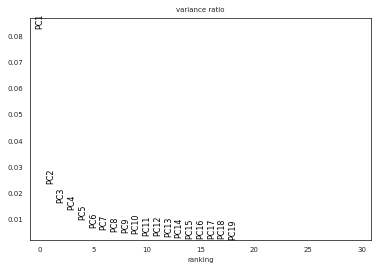

In [28]:
sc.tl.pca(adata, svd_solver='arpack',n_comps=n_comps) 
sc.pl.pca_variance_ratio(adata,log=False)

In [29]:
sc.pp.neighbors(adata, n_neighbors=10, method= 'umap', n_pcs=n_comps)
sc.tl.umap(adata)

In [30]:
sc.tl.tsne(adata, random_state = 7)

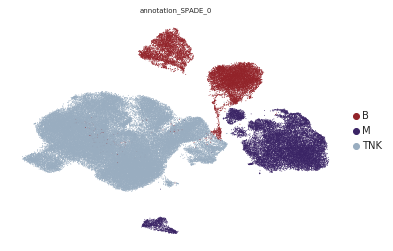

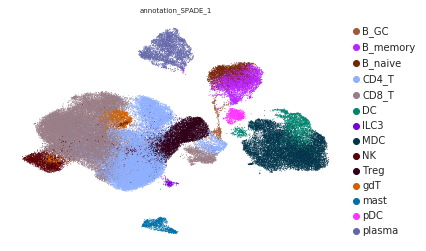

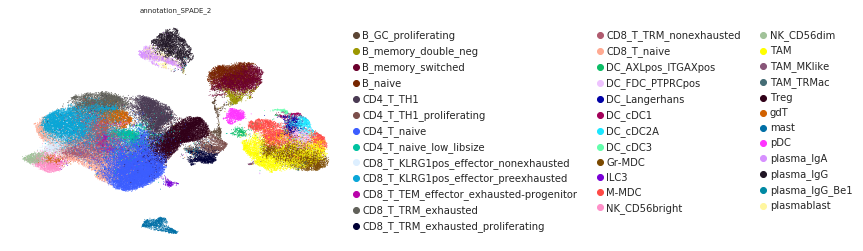

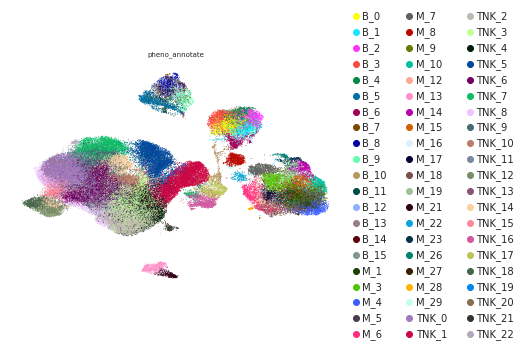

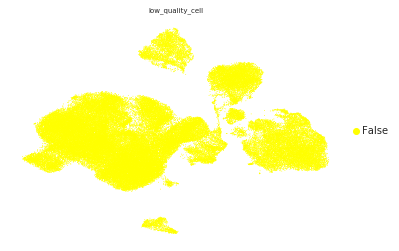

In [31]:
sc.pl.umap(adata, color = ['annotation_SPADE_0'], s = 3, palette=subtype_color_dict, legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_1'], s = 3, palette=subtype_color_dict, legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_2'], s = 3, palette=subtype_color_dict, legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['pheno_annotate'], s = 3, palette=color_map_clusters_nogrey, legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['low_quality_cell'], s = 3, palette=color_map_clusters_nogrey, legend_fontsize = 10, vmin=0)

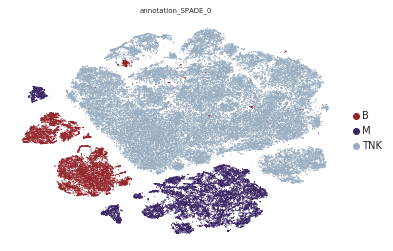

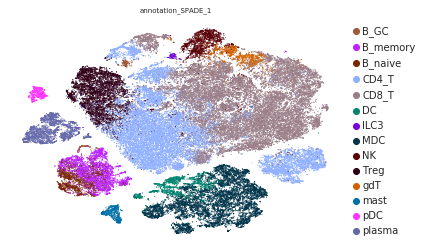

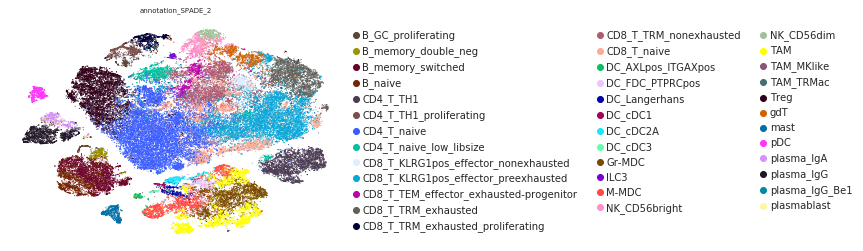

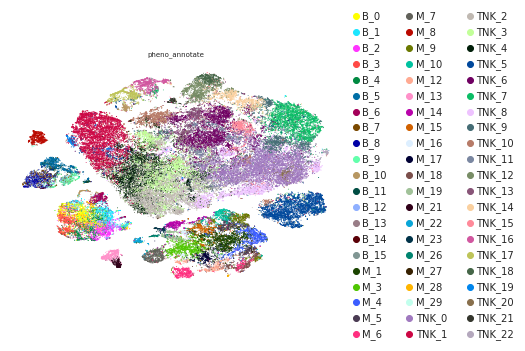

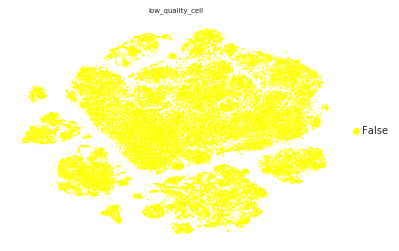

In [33]:
sc.pl.tsne(adata, color = ['annotation_SPADE_0'], s = 3, palette=subtype_color_dict, legend_fontsize = 10, vmin=0)
sc.pl.tsne(adata, color = ['annotation_SPADE_1'], s = 3, palette=subtype_color_dict, legend_fontsize = 10, vmin=0)
sc.pl.tsne(adata, color = ['annotation_SPADE_2'], s = 3, palette=subtype_color_dict, legend_fontsize = 10, vmin=0)
sc.pl.tsne(adata, color = ['pheno_annotate'], s = 3, palette=color_map_clusters_nogrey, legend_fontsize = 10, vmin=0)
sc.pl.tsne(adata, color = ['low_quality_cell'], s = 3, palette=color_map_clusters_nogrey, legend_fontsize = 10, vmin=0)

In [32]:
adata.write(adata_save_path)
print('adata saved to:', adata_save_path)

adata saved to: /data/peer/wallet/Jupyter/2021_SPADE/2021_Bassez_BRCA/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_raw_filtered_clustered_drops_annotated_nodrops_log1p_clustered_leukocytes_scran_annotated_clustered_imputed_hvgenes_andmarker_15000_clustered_imputed_v2_210501_annotated_211208.h5ad


In [14]:
sc.tl.draw_graph(adata, layout='fa', init_pos=None, root=None, random_state=0, n_jobs=None, adjacency=None, key_added_ext=None, neighbors_key=None, obsp=None, copy=False)
sc.tl.diffmap(adata, n_comps=15, neighbors_key=None, copy=False)

In [17]:
adata.write(adata_save_path)
print('adata saved to:', adata_save_path)

adata saved to: /data/peer/wallet/Jupyter/2021_SPADE/2021_Bassez_BRCA/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_raw_filtered_clustered_drops_annotated_nodrops_log1p_clustered_leukocytes_scran_annotated_clustered_imputed_hvgenes_andmarker_15000_clustered_imputed_v2_210501_annotated_211208.h5ad


# relabel plasma cell T cell doublet

In [3]:
adata_path='/data/peer/wallet/Jupyter/SPADE_Peer_validation/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded.h5ad'
adata_save_path = '/data/peer/wallet/Jupyter/SPADE_Peer_validation/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_nodub220818.h5ad'

In [4]:
adata = sc.read(adata_path)


Only considering the two last: ['.0_50PC_reembedded', '.h5ad'].
Only considering the two last: ['.0_50PC_reembedded', '.h5ad'].


In [13]:
adata_sub = adata[adata.obs['annotation_SPADE_1'].isin(['B','plasma'])]
adata_sub.obs['annotation_SPADE_2'].value_counts(normalize=True)

plasma_IgG        0.625223
plasma_IgA        0.247383
plasmablast       0.098290
plasma_IgG_Be1    0.029104
Name: annotation_SPADE_2, dtype: float64

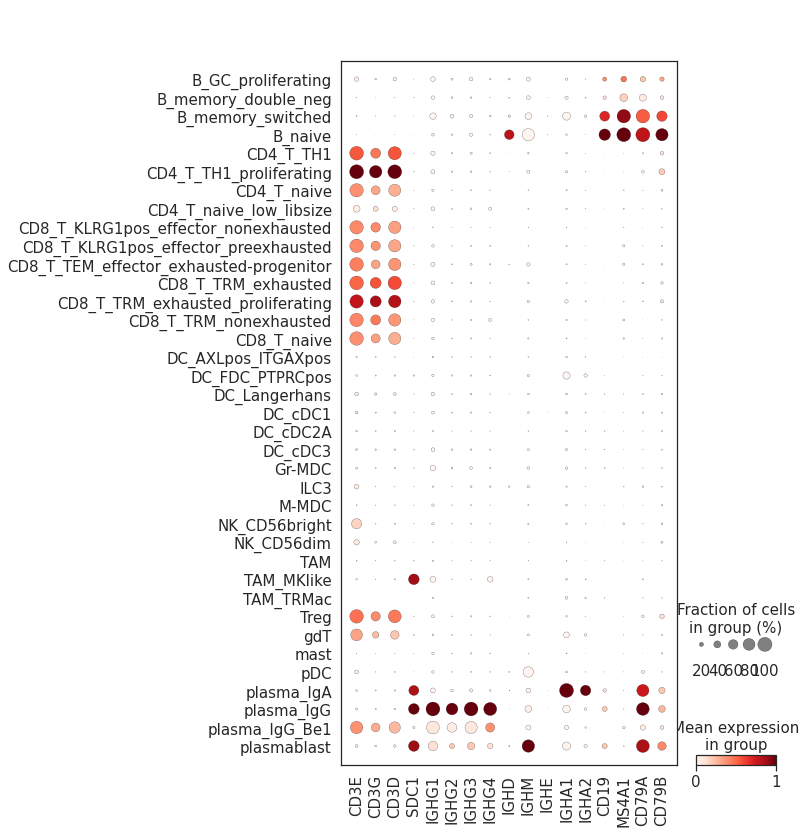

In [9]:
#dotplot
%matplotlib inline
pheno_heat = 'annotation_SPADE_2'
adata_plot = adata
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.pl.dotplot(adata_plot, ['CD3E','CD3G','CD3D','SDC1','IGHG1','IGHG2','IGHG3','IGHG4','IGHD','IGHM',
                           'IGHE','IGHA1','IGHA2','CD19','MS4A1','CD79A','CD79B'], groupby=pheno_heat, standard_scale='var',
             )

In [97]:
set(adata.obs['annotation_SPADE_2'])

{'B_GC_proliferating',
 'B_memory_double_neg',
 'B_memory_switched',
 'B_naive',
 'CD4_T_TH1',
 'CD4_T_TH1_proliferating',
 'CD4_T_naive',
 'CD4_T_naive_low_libsize',
 'CD8_T_KLRG1pos_effector_nonexhausted',
 'CD8_T_KLRG1pos_effector_preexhausted',
 'CD8_T_TEM_effector_exhausted-progenitor',
 'CD8_T_TRM_exhausted',
 'CD8_T_TRM_exhausted_proliferating',
 'CD8_T_TRM_nonexhausted',
 'CD8_T_naive',
 'DC_AXLpos_ITGAXpos',
 'DC_FDC_PTPRCpos',
 'DC_Langerhans',
 'DC_cDC1',
 'DC_cDC2A',
 'DC_cDC3',
 'Gr-MDC',
 'ILC3',
 'M-MDC',
 'NK_CD56bright',
 'NK_CD56dim',
 'TAM',
 'TAM_MKlike',
 'TAM_TRMac',
 'Treg',
 'gdT',
 'mast',
 'pDC',
 'plasma_IgA',
 'plasma_IgG',
 'plasma_IgG_Be1',
 'plasmablast'}

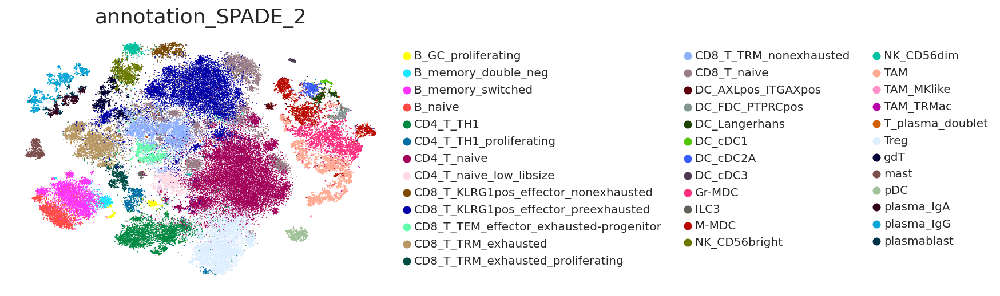

In [102]:
sc.pl.tsne(adata, color = ['annotation_SPADE_2'], s = 3, palette=color_map_clusters, legend_fontsize = 10, vmin=0)

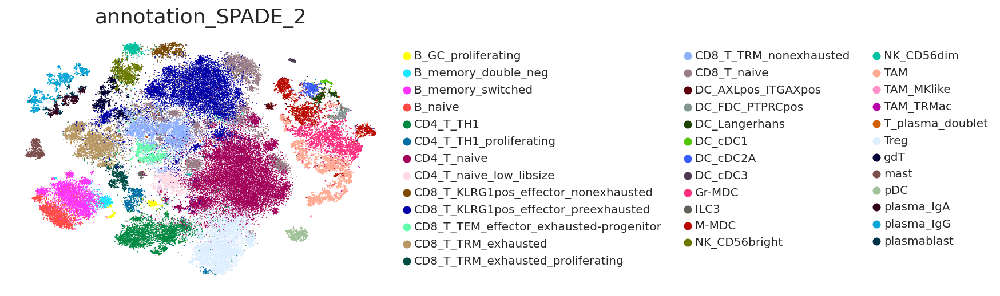

In [103]:
relabel_list = [x if x != 'plasma_IgG_Be1' else 'T_plasma_doublet'for x in adata.obs['annotation_SPADE_2'] ]

adata.obs['annotation_SPADE_2'] =relabel_list

sc.pl.tsne(adata, color = ['annotation_SPADE_2'], s = 3, palette=color_map_clusters, legend_fontsize = 10, vmin=0)

In [106]:
adata_sub = adata[adata.obs['annotation_SPADE_2']=='T_plasma_doublet']
adata_sub_= adata[adata.obs['annotation_SPADE_1']=='plasma']


print('doublet content is:', len(adata_sub.obs['annotation_SPADE_2'])/len(adata.obs['annotation_SPADE_2']),'of all cells')
print('doublet content is:', len(adata_sub.obs['annotation_SPADE_2'])/len(adata_sub_.obs['annotation_SPADE_2']),'of plasma')


doublet content is: 0.0011648937800803163 of all cells
doublet content is: 0.02910390605054889 of plasma


In [107]:
adata

AnnData object with n_obs × n_vars = 97863 × 19984
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k2

In [108]:
adata = adata[adata.obs['annotation_SPADE_2']!='T_plasma_doublet']
adata

View of AnnData object with n_obs × n_vars = 97749 × 19984
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'phen

In [111]:
adata.write(adata_save_path)
print('saved data to:',adata_save_path)

saved data to: /data/peer/wallet/Jupyter/SPADE_Peer_validation/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_nodub220818.h5ad


In [10]:
adata = sc.read('/data/peer/wallet/Jupyter/SPADE_Peer_validation/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_nodub220818.h5ad')

Only considering the two last: ['.0_50PC_reembedded_nodub220818', '.h5ad'].
Only considering the two last: ['.0_50PC_reembedded_nodub220818', '.h5ad'].


In [11]:
adata

AnnData object with n_obs × n_vars = 97749 × 19984
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k2

In [13]:
a = magic(adata, copy=True, verbose=True, solver= 'exact', n_pca=adata.obsm['X_pca'].shape[1], knn=5, t=3)
adata.layers['imputed'] = a.X

Calculating MAGIC...
  Running MAGIC on 97749 cells and 19984 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 47.11 seconds.
    Calculating KNN search...
    Calculated KNN search in 777.49 seconds.
    Calculating affinities...
    Calculated affinities in 782.75 seconds.
  Calculated graph and diffusion operator in 1607.52 seconds.
  Running MAGIC with `solver='exact'` on 19984-dimensional data may take a long time. Consider denoising specific genes with `genes=<list-like>` or using `solver='approximate'`.
  Calculating imputation...
  Calculated imputation in 127.28 seconds.


/home/wallet/.local/lib/python3.10/site-packages/magic/utils.py:145: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  data = anndata.AnnData(data)


Calculated MAGIC in 1740.20 seconds.


In [14]:
adata.write('/data/peer/wallet/Jupyter/SPADE_Peer_validation/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_nodub220818.h5ad')

# plot cell type markers

In [11]:
adata_path = '/data/peer/wallet/Jupyter/SPADE_Peer_validation/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_nodub220818.h5ad'


In [12]:
adata = sc.read(adata_path)
adata

Only considering the two last: ['.0_50PC_reembedded_nodub220818', '.h5ad'].
Only considering the two last: ['.0_50PC_reembedded_nodub220818', '.h5ad'].


AnnData object with n_obs × n_vars = 97749 × 19984
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k2

In [13]:
#load cellular identity markers
marker_df_path = '/data/peer/wallet/Jupyter/SPADE_Peer_validation/SPECTRA_celltypes_x_genesets_x_versions_x_genes.csv'
cell_type_marker_df = pd.read_csv(marker_df_path)
cell_type_marker_df

,c.name,gs.name,v.id,g.name,g.ENSEMBL
0,T,T_UP,v_hs317,CD3E,ENSG00000198851
1,T,T_UP,v_hs317,CD3D,ENSG00000167286
2,T,T_UP,v_hs317,CD3G,ENSG00000160654
3,B,B_UP,v_hs318,CD79A,ENSG00000105369
4,B,B_UP,v_hs318,CD79B,ENSG00000007312
...,...,...,...,...,...
601,CD4-T,T_CD4-T_UP,v_hs309,IL21,ENSG00000138684
602,CD4-T,T_CD4-T_UP,v_hs309,IL17B,ENSG00000127743
603,CD4-T,T_CD4-T_UP,v_hs309,CD40LG,ENSG00000102245
604,CD4-T,T_CD4-T_UP,v_hs309,ICOS,ENSG00000163600


In [14]:
#extract cell types of interest

celltype_gs = ['T','CD8-T','CD4-T','Treg','gdT', 'NK','ILC3-NCRpos','B', 'B-naive','B-memory','GC-B','plasma','plasma-blast','p-DC','cDC1','cDC2','cDC3','Langerhans',
        'mo-DC','FDC','mono','Mac', 'gran', 'mast']

cell_type_marker_df_subset = cell_type_marker_df[cell_type_marker_df['c.name'].isin(celltype_gs)]

#create dictionary 

marker_dict = {}

for i in set(cell_type_marker_df_subset['c.name']):
    marker_dict[i] = list(cell_type_marker_df_subset[cell_type_marker_df_subset['c.name']==i]['g.name'])

marker_dict

{'cDC1': ['DPP4',
  'CLEC9A',
  'THBD',
  'CD8A',
  'BTLA',
  'IRF8',
  'XCR1',
  'ID2',
  'CADM1',
  'CD226',
  'CXCL10',
  'CD33',
  'CXCL9',
  'BATF3'],
 'T': ['CD3E', 'CD3D', 'CD3G'],
 'B-naive': ['CCR7', 'CD40', 'SELL', 'IGHD'],
 'CD8-T': ['TRBC1',
  'TRAC',
  'TRBC2',
  'GZMB',
  'PRF1',
  'GZMA',
  'EOMES',
  'CD8A',
  'CD8B'],
 'plasma-blast': ['XBP1',
  'IL6RA',
  'ZBTB20',
  'TNFRSF17',
  'IL6ST',
  'CXCR4',
  'IRF4',
  'HLA-DPB1',
  'HLA-DQB1',
  'HLA-DQA1',
  'HLA-DRA',
  'HLA-DPA1',
  'CD27',
  'HLA-DMB',
  'MKI67',
  'HLA-DRB4',
  'HLA-DMA',
  'HLA-DRB3',
  'HLA-DOB',
  'CD38',
  'SLAMF7'],
 'CD4-T': ['TRAC',
  'TRBC2',
  'TRBC1',
  'IL17A',
  'RORC',
  'IL6',
  'CD4',
  'BCL6',
  'IL21',
  'IL17B',
  'CD40LG',
  'ICOS',
  'GATA3'],
 'mono': ['FCGR1B',
  'FCGR2A',
  'FCGR2B',
  'FCGR1A',
  'TLR2',
  'CR1',
  'ITGAM',
  'SPI1',
  'RXRA',
  'CD14',
  'CEBPA'],
 'Treg': ['ENTPD1',
  'IL2RA',
  'TGFB1',
  'NT5E',
  'TNFRSF9',
  'TNFRSF18',
  'FOXP3',
  'CTLA4'],
 'p-DC': ['FC

In [15]:
marker_dict['gran']

['CXCR2',
 'CSF3R',
 'ACOD1',
 'CEACAM8',
 'FFAR4',
 'MPO',
 'CD24',
 'CTSG',
 'FUT4',
 'LTF',
 'CXCR1',
 'FCGR3B',
 'VASP',
 'ELANE',
 'AZU1']

In [16]:
#filter dict for genes not contained in the data

marker_dict_clean = OrderedDict()

for i in celltype_gs:
        marker_dict_clean[i] = [x for x in marker_dict[i] if x in adata.var_names]

In [17]:
row_order = [ 'CD8_T_KLRG1pos_effector_nonexhausted',
 'CD8_T_KLRG1pos_effector_preexhausted',
 'CD8_T_TEM_effector_exhausted-progenitor',
 'CD8_T_TRM_exhausted',
 'CD8_T_TRM_exhausted_proliferating',
 'CD8_T_TRM_nonexhausted',
 'CD8_T_naive',
'CD4_T_TH1',
 'CD4_T_TH1_proliferating',
 'CD4_T_naive',
 'CD4_T_naive_low_libsize',
'Treg',
 'gdT',
      'ILC3',
 'NK_CD56bright',
 'NK_CD56dim',
    'B_naive',
 'B_memory_double_neg',
 'B_memory_switched',
 'B_GC_proliferating',
 'plasma_IgA',
 'plasma_IgG',
 'plasmablast',
 'pDC',
 'DC_cDC1',
 'DC_cDC2A',
 'DC_cDC3',
 'DC_Langerhans',
 'DC_AXLpos_ITGAXpos',
 'DC_FDC_PTPRCpos',
 'M-MDC',
 'TAM',
 'TAM_MKlike',
 'TAM_TRMac',
'Gr-MDC',
 'mast',]

In [18]:
set(adata.obs['annotation_SPADE_2'])

{'B_GC_proliferating',
 'B_memory_double_neg',
 'B_memory_switched',
 'B_naive',
 'CD4_T_TH1',
 'CD4_T_TH1_proliferating',
 'CD4_T_naive',
 'CD4_T_naive_low_libsize',
 'CD8_T_KLRG1pos_effector_nonexhausted',
 'CD8_T_KLRG1pos_effector_preexhausted',
 'CD8_T_TEM_effector_exhausted-progenitor',
 'CD8_T_TRM_exhausted',
 'CD8_T_TRM_exhausted_proliferating',
 'CD8_T_TRM_nonexhausted',
 'CD8_T_naive',
 'DC_AXLpos_ITGAXpos',
 'DC_FDC_PTPRCpos',
 'DC_Langerhans',
 'DC_cDC1',
 'DC_cDC2A',
 'DC_cDC3',
 'Gr-MDC',
 'ILC3',
 'M-MDC',
 'NK_CD56bright',
 'NK_CD56dim',
 'TAM',
 'TAM_MKlike',
 'TAM_TRMac',
 'Treg',
 'gdT',
 'mast',
 'pDC',
 'plasma_IgA',
 'plasma_IgG',
 'plasmablast'}

In [19]:
list_small = ['CD19','MS4A1','CD79A','CD79B','AICDA','BCL6','SDC1','IGHG1','IGHA1','IGHE','IGHD','IGHM',
             'CD3E','CD3G','CD3D','TRAC','TRBC1','TRBC2','TRGC','TRDC','CD8A','CD8B','CD4','FOXP3','IL2RA','ITGAX',
              'ID2','IRF4','IRF8','IRF7','TCF4','CLEC4A','BATF3','XCR1',
             'KIT','NCR1','NCAM1','PRF1','TPSAB1','TPSB2','S100A8','S100A9','CD14','CD68','MARCO','CD36','APOE']

list_small = list(set([x for x in list_small if x in adata.var_names]))

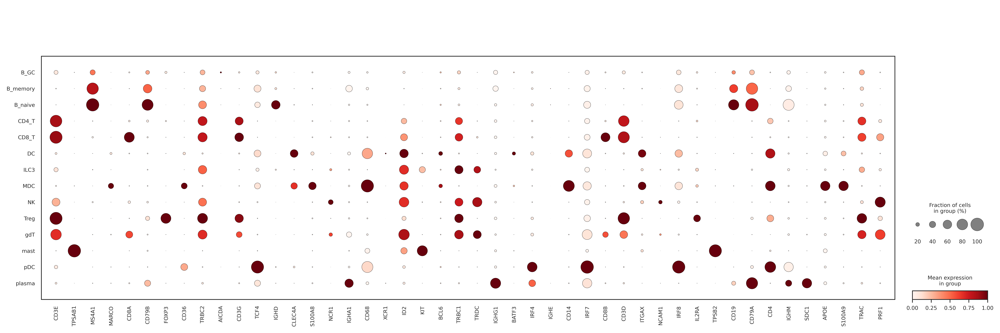

In [20]:
fontscale=1
pheno_heat = 'annotation_SPADE_1'

sc.pl.dotplot(adata,list_small , groupby=pheno_heat, standard_scale='var',
            return_fig=False , save='Bassez_markers_basic.svg')

saved Figure to: Bassez_allcells_markers_dotplot_220819.svg


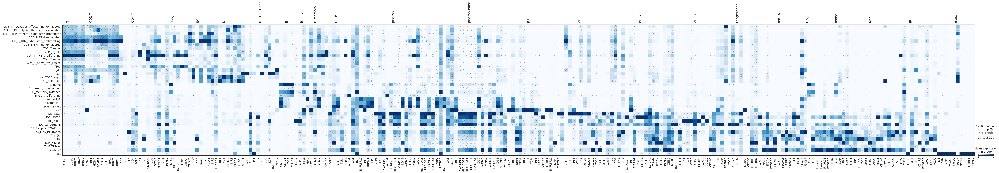

In [68]:
#dotplot
%matplotlib inline
save_name = 'Bassez_allcells_markers_dotplot_220819.svg'
pheno_heat = 'annotation_SPADE_2'
adata_plot = adata
sns.set(font_scale = 1.5)
sns.set_style('white')
dp = sc.pl.dotplot(adata_plot, marker_dict_clean, groupby=pheno_heat, standard_scale='var',
             categories_order = row_order,return_fig=True,save=save_name).style(color_on='square', cmap='Blues',
                                                                )
dp.savefig(save_name)
print('saved Figure to:',save_name)